# Проєкт "Створення моделі машинного навчання для прогнозування поширення СOVID-19 у світі"

Мета: створити модель машинного навчання для прогнозування поширення СOVID-19 у світі

# 1. Збір та попередня обробка даних

## 1.1 Визначення джерел даних

Для вирішення даного завдання було обрано датасет з https://www.kaggle.com/datasets/caesarmario/our-world-in-data-covid19-dataset

## 1.2 Попередня підготовка та дослідження даних.

Виконаємо імпорт бібліотек для моделі Prophet.

In [1]:
import numpy as np
import pandas as pd
from math import sqrt

from datetime import datetime

from sklearn.metrics import mean_absolute_error, mean_squared_error

from prophet import Prophet

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import graph_objs as go

import matplotlib.pyplot as plt
%matplotlib inline

import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
    
init_notebook_mode(connected = True)

Виконаємо імпорт бібліотек для моделі SARIMAX.

In [2]:
from pandas.plotting import scatter_matrix
from adtk.data import validate_series
from adtk.visualization import plot
from adtk.detector import ThresholdAD
from adtk.detector import OutlierDetector

from sklearn.neighbors import LocalOutlierFactor
from scipy.stats import variation
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.api import ExponentialSmoothing
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
from statsmodels.stats.outliers_influence import variance_inflation_factor
from itertools import compress, product
import itertools

from pmdarima import auto_arima

import warnings
warnings.filterwarnings("ignore")

In [3]:
# Функція для оцінки метрик моделей
def metrics(real, forecast):
    
    if type(real)==pd.core.frame.DataFrame:
        real=real[real.columns[0]].values
    
    print("Тест на стаціонарність:")
    dftest = adfuller(real-forecast, autolag='AIC')
    print("\tT-статистика = {:.3f}".format(dftest[0]))
    print("\tP-значення = {:.3f}".format(dftest[1]))
    print("Критичне значення :")
    for k, v in dftest[4].items():
        print("\t{}: {} - Дані {} стационарні з ймовірністю {}% відсотків".format(k, v, "не" if v<dftest[0] else "", 100-int(k[:-1])))
    
    forecast=np.array(forecast)
    print('MAD:', round(abs(real-forecast).mean(),4))
    print('MSE:', round(((real-forecast)**2).mean(),4))
    print('MAPE:', round((abs(real-forecast)/real).mean(),4))
    print('MPE:', round(((real-forecast)/real).mean(),4))
    print('Стандартна похибка:', round(((real-forecast)**2).mean()**0.5,4)) 

In [4]:
# Читаємо датасет
df = pd.read_csv('owid-covid-data.csv')

In [5]:
df

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
309552,ZWE,Africa,Zimbabwe,2023-05-06,264685.0,0.0,0.857,5686.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
309553,ZWE,Africa,Zimbabwe,2023-05-07,264685.0,0.0,0.286,5686.0,0.0,0.000,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
309554,ZWE,Africa,Zimbabwe,2023-05-08,264776.0,91.0,13.000,5689.0,3.0,0.429,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
309555,ZWE,Africa,Zimbabwe,2023-05-09,264776.0,0.0,13.000,5689.0,0.0,0.429,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN


Досліджуємо датасет

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309557 entries, 0 to 309556
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    309557 non-null  object 
 1   continent                                   294869 non-null  object 
 2   location                                    309557 non-null  object 
 3   date                                        309557 non-null  object 
 4   total_cases                                 273627 non-null  float64
 5   new_cases                                   300906 non-null  float64
 6   new_cases_smoothed                          299642 non-null  float64
 7   total_deaths                                252976 non-null  float64
 8   new_deaths                                  301000 non-null  float64
 9   new_deaths_smoothed                         299770 non-null  float64
 

Вхідний датасет складається з даних, зібраних протягом останніх трьох років. Він включає такі дані по країнам як кількість нових випадків короновірусу в день, кумулятивний показник - загальна кількість хворих на певну дату, кількість нових випадків сметней внаслідок короновірусу в день, кількість вакцинованих в день, кількість населення, розвинутість країни тощо.
В подальшому дослідження буде зосереджено на таких показниках:
 1. кількість нових випадків короновірусу в день (new_cases);
 2. кількість нових випадків сметней внаслідок короновірусу в день (new_deaths);
 3. кількість вакцинованих в день (new_people_vaccinated_smoothed).

In [7]:
"""
Визначимо локації, дані по яким представені в датасеті.
"""
list_of_locations = list(set(df['location'].values))
list_of_locations

['Turkey',
 'Colombia',
 'Spain',
 'Senegal',
 'Malawi',
 'Serbia',
 'Guadeloupe',
 'Belize',
 'Guernsey',
 'Peru',
 'Northern Mariana Islands',
 'Austria',
 "Cote d'Ivoire",
 'Armenia',
 'Isle of Man',
 'Palau',
 'Lithuania',
 'Mongolia',
 'Syria',
 'Tanzania',
 'Comoros',
 'Democratic Republic of Congo',
 'Chad',
 'Bermuda',
 'Martinique',
 'Moldova',
 'Northern Ireland',
 'Tuvalu',
 'Jamaica',
 'Reunion',
 'India',
 'Czechia',
 'American Samoa',
 'Albania',
 'Nauru',
 'Africa',
 'Guinea-Bissau',
 'Mauritania',
 'Kyrgyzstan',
 'Montenegro',
 'Marshall Islands',
 'Kosovo',
 'Kazakhstan',
 'South Korea',
 'Japan',
 'Trinidad and Tobago',
 'Burkina Faso',
 'Namibia',
 'Norway',
 'Guyana',
 'Upper middle income',
 'Paraguay',
 'Zambia',
 'Low income',
 'Central African Republic',
 'Falkland Islands',
 'Haiti',
 'Algeria',
 'Sri Lanka',
 'Tonga',
 'Cambodia',
 'China',
 'Ecuador',
 'Turks and Caicos Islands',
 'Guatemala',
 'Seychelles',
 'Botswana',
 'Honduras',
 'Palestine',
 'Uganda',


In [8]:
"""
Обираємо для аналізу частину датасету, яка описує ситуацію 
з короновірусом у всьому світі. Зберігаємо у змінну df_world.
"""
df_world = df.loc[df['location']=='World']

## 1.3 Попередня обробка та візуалізація даних

### 1.3.1 Візуалізація кумулятивних показників по країнам

Для візуалізації даних обираємо кумулятивні показники поширення хвороби та смертності.

In [9]:
"""Оскільки датасет містить дані не лише по окремим країнам,
для візуалізації видаляємо частину датасету, які стосуються цілих регіонів"""
df = df.loc[df['location'] !='World']
df = df.loc[df['location'] !='High income']
df = df.loc[df['location'] !='Asia']
df = df.loc[df['location'] !='Europe']
df = df.loc[df['location'] !='Upper middle income']
df = df.loc[df['location'] !='European Union']
df = df.loc[df['location'] !='North America']

In [10]:
"""
Перевіряємо, щоб максимаьная кількість хворих стосувалася окремої країни,
а не цілого регіону
"""
df.loc[df.index == df['total_cases'].idxmax(axis=0, skipna=True)]

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
292512,USA,North America,United States,2023-05-07,103343569.0,77165.0,11023.571,1125209.0,1146.0,163.714,...,24.6,NaN,2.77,78.86,0.926,338289856.0,NaN,NaN,NaN,NaN


In [11]:
import plotly.express as px

In [12]:
fig = px.choropleth(data_frame = df, 
                    locations = 'location',
                    locationmode = 'country names',
                    projection = 'natural earth', 
                    color = 'total_cases',
                    animation_frame='date',
                    color_continuous_scale='viridis_r',
                    range_color=[0, df['total_cases'].max()])

# add map and colorbar titles to the figure
fig.update_layout(title_text= 'Choropleth Map of Covid-19 Confirmed Cases to Date', 
                  coloraxis_colorbar_title = 'total_cases')

# show the figure
fig.show()

In [13]:
fig = px.choropleth(data_frame = df, 
                    locations = 'location',
                    locationmode = 'country names',
                    projection = 'natural earth', 
                    color = 'total_deaths',
                    animation_frame='date',
                    color_continuous_scale='viridis_r',
                    range_color=[0, df['total_deaths'].max()])

# add map and colorbar titles to the figure
fig.update_layout(title_text= 'Choropleth Map of Covid-19 Confirmed Deaths to Date', 
                  coloraxis_colorbar_title = 'total_deaths')

# show the figure
fig.show()

### 1.3.2 Попередня підготовка датасету

In [14]:
"""Визначаємо ознаки для подальшого аналізу"""
list_of_features = ['total_cases',
                    'new_cases',
                    'new_cases_smoothed',
                    'total_deaths',
                    'new_deaths',
                    'new_deaths_smoothed',
                    'total_vaccinations',
                    'people_vaccinated',
                    'people_fully_vaccinated',
                    'total_boosters',
                    'new_vaccinations',
                    'new_vaccinations_smoothed',
                    'new_people_vaccinated_smoothed']

In [15]:
"""Вмонуємо попередню обробку даних: заповнення NaN, встановення дат в якості індексу
для часового ряду, видалення зайвих колонок тощо.
"""
df_general = df_world
df_general.index = df_general.date
df_general.index = pd.to_datetime(df_general.index)
df_general.drop(columns = ['iso_code', 'continent', 'location', 'date'], 
                axis = 1, inplace=True)
df_general = df_general.fillna(0)
df_general = df_general[list_of_features]
df_general

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-04,3.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-05,3.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-06,6.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-07,6.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-06,765649778.0,43855.0,90200.286,6924953.0,257.0,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0.0
2023-05-07,765834346.0,184568.0,85135.286,6927075.0,2123.0,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0.0
2023-05-08,765893470.0,59124.0,76979.571,6927288.0,213.0,520.000,1.337900e+10,5.580601e+09,5.132054e+09,2.763256e+09,0.0,0.0,0.0


In [16]:
"""Видаляємо останні рядки, які не містять інформаці по новим випадкам короновірусу
(датасет оновлюється приблизно раз на тиждень)"""
df_general.drop(df_general.tail(1).index, inplace = True)

In [17]:
"""Зберігаємо датасет"""
df_general.to_csv('df_general_covid.csv')

In [18]:
df_general = pd.read_csv('df_general_covid.csv').set_index('date')
df_general.index = pd.to_datetime(df_general.index)
df_general

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-04,3.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-05,3.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-06,6.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-07,6.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-05,765605923.0,70211.0,92974.571,6924696.0,257.0,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0.0
2023-05-06,765649778.0,43855.0,90200.286,6924953.0,257.0,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0.0
2023-05-07,765834346.0,184568.0,85135.286,6927075.0,2123.0,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0.0


In [19]:
df_general.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1223 entries, 2020-01-03 to 2023-05-09
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   total_cases                     1223 non-null   float64
 1   new_cases                       1223 non-null   float64
 2   new_cases_smoothed              1223 non-null   float64
 3   total_deaths                    1223 non-null   float64
 4   new_deaths                      1223 non-null   float64
 5   new_deaths_smoothed             1223 non-null   float64
 6   total_vaccinations              1223 non-null   float64
 7   people_vaccinated               1223 non-null   float64
 8   people_fully_vaccinated         1223 non-null   float64
 9   total_boosters                  1223 non-null   float64
 10  new_vaccinations                1223 non-null   float64
 11  new_vaccinations_smoothed       1223 non-null   float64
 12  new_people_vacci

В обробленому датасеті зібрані дані по таким ознакам:


| Feature                        | Explanation                                                                                              |
|--------------------------------|---------------------------------------------------------------------------------------------------------|
| total_cases                     | Total confirmed cases of COVID-19                                                                        |
| new_cases                       | New confirmed cases of COVID-19                                                                          |
| new_cases_smoothed              | Smoothed daily new confirmed COVID-19 cases (7-day smoothed)                                            |
| total_deaths                    | Total deaths attributed to COVID-19                                                                      |
| new_deaths                      | New deaths attributed to COVID-19                                                                        |
| new_deaths_smoothed             | Smoothed daily new deaths attributed to COVID-19 (7-day smoothed)                                       |
| total_vaccinations              | Total number of COVID-19 vaccination doses administered                                                 |
| people_vaccinated               | Total number of people who received at least one dose of COVID-19 vaccine                               |
| people_fully_vaccinated         | Total number of people who received all doses prescribed by the vaccination protocol                   |
| total_boosters                  | Total number of COVID-19 booster doses administered                                                     |
| new_vaccinations                | New COVID-19 vaccination doses administered                                                             |
| new_vaccinations_smoothed       | Smoothed daily new COVID-19 vaccination doses administered (7-day smoothed)                            |
| new_people_vaccinated_smoothed  | Smoothed daily new people vaccinated (7-day smoothed).                                                  |



In [20]:
df_general.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
count,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1223.000000,1223.000000,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03
mean,3.013432e+08,6.262629e+05,6.260957e+05,3.973484e+06,5669.578087,5668.228242,6.024532e+09,2.720935e+09,2.340521e+09,9.098909e+08,1.093207e+07,1.093108e+07,4.048592e+06
std,2.649754e+08,7.903873e+05,7.632848e+05,2.492672e+06,4070.498370,3961.558534,5.601857e+09,2.414702e+09,2.230270e+09,1.132487e+09,1.330365e+07,1.302708e+07,5.602577e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,4.856619e+07,2.368775e+05,2.407710e+05,1.321866e+06,1751.500000,1645.642500,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.207932e+08,4.620450e+05,4.694206e+05,4.618729e+06,5630.000000,5792.000000,5.531856e+09,3.199700e+09,2.201025e+09,2.160832e+07,5.014499e+06,5.531410e+06,1.354674e+06
75%,5.514580e+08,6.652825e+05,6.483359e+05,6.375276e+06,8464.000000,8685.143000,1.214252e+10,5.242831e+09,4.811244e+09,2.142963e+09,1.967606e+07,1.935283e+07,6.857527e+06
max,7.659025e+08,7.460827e+06,6.410668e+06,6.927365e+06,20028.000000,14680.286000,1.337918e+10,5.580601e+09,5.132054e+09,2.763435e+09,4.967335e+07,4.369294e+07,2.107120e+07


### 1.3.3 Візуалізація залежностей між показниками

In [21]:
import seaborn as sns

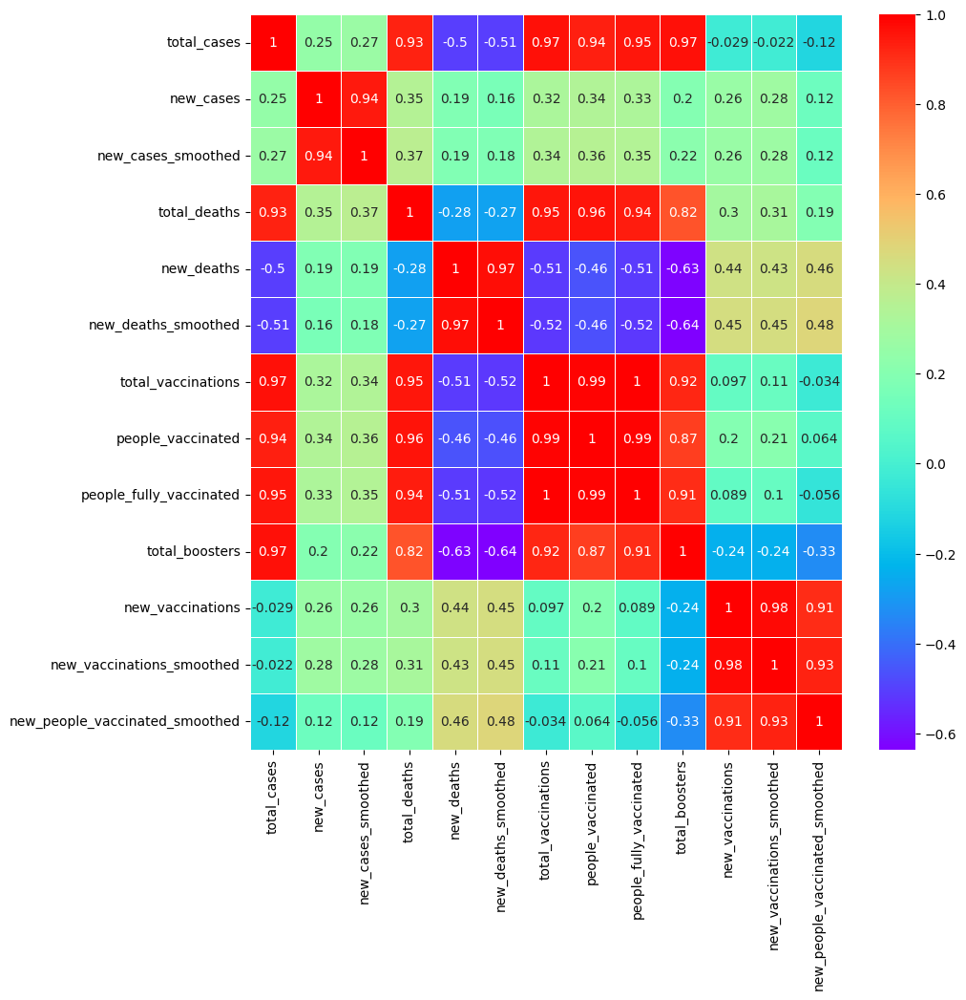

In [22]:
# Correlation matrix for features
corr_matrix = df_general.corr()
plt.figure(figsize=(10,10)) 
sns.heatmap(corr_matrix, annot=True, cmap='rainbow', linewidths=0.5)
plt.show()

З матриці кореляцій чітко видно зворотню залежність між кількістю вакцинованих та кількістю смертей. 

### 1.3.4 Box plot для нових випадків хвороби

In [23]:
def create_features(df):
    """
    Create time series features based on time series index.
    """
    df = df.copy()
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    return df

In [24]:
df_case = df_general[['new_cases']].copy()
df = create_features(df_case)

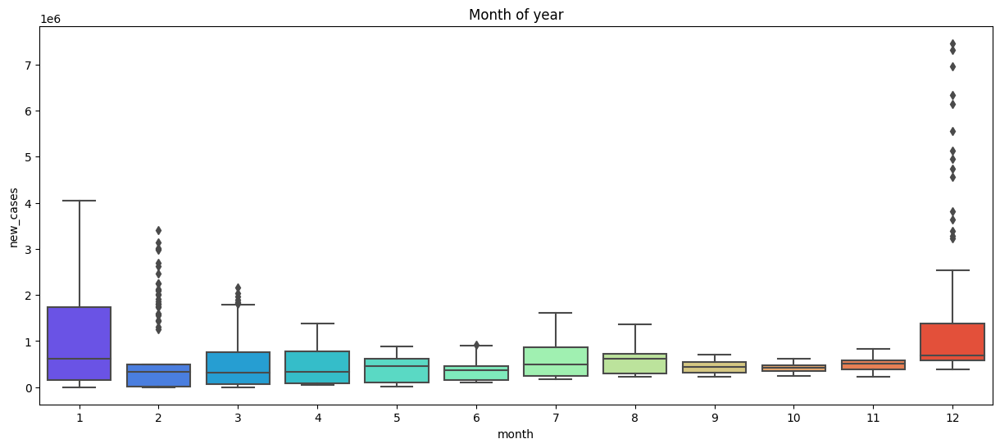

In [25]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(data=df, x='month', y='new_cases', palette='rainbow')
ax.set_title('Month of year')
plt.show()

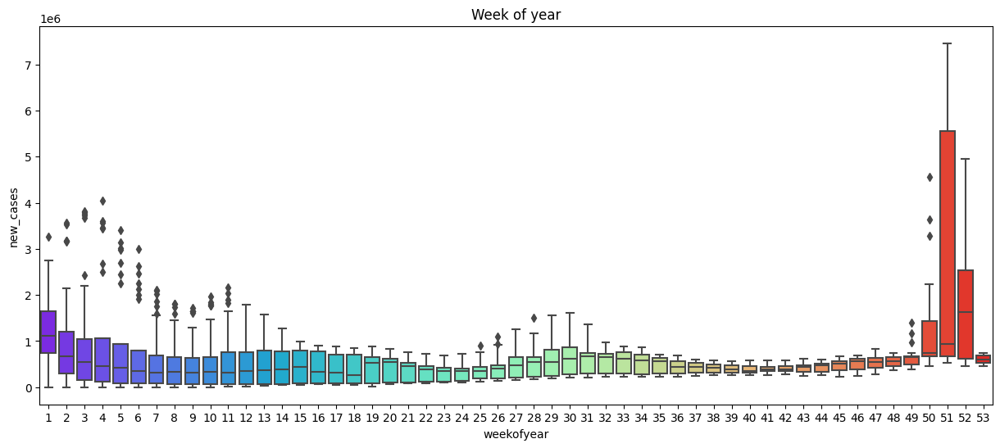

In [26]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(data=df, x='weekofyear', y='new_cases', palette='rainbow')
ax.set_title('Week of year')
plt.show()

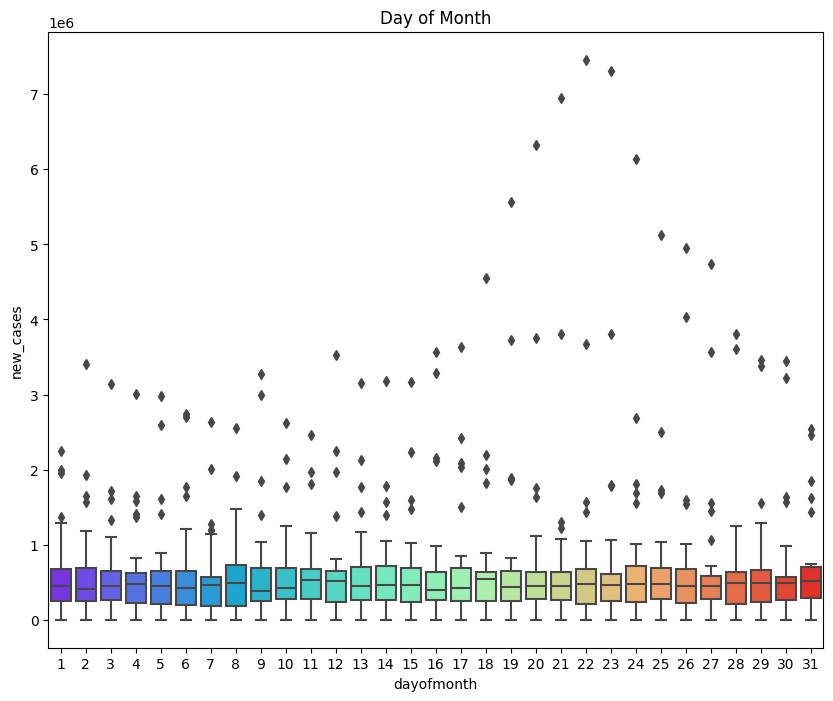

In [27]:
fig, ax = plt.subplots(figsize=(10, 8))
sns.boxplot(data=df, x='dayofmonth', y='new_cases', palette='rainbow')
ax.set_title('Day of Month')
plt.show()

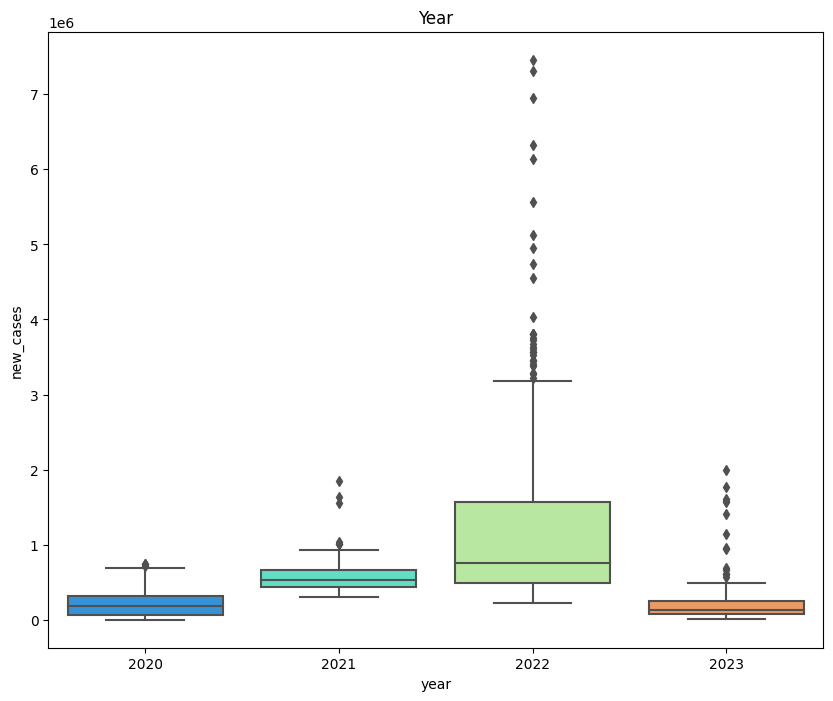

In [28]:
fig, ax = plt.subplots(figsize=(10,8))
sns.boxplot(data=df, x='year', y='new_cases', palette='rainbow')
ax.set_title('Year')
plt.show()

### 1.3.5 Графіки new_cases, new_deaths, new_people_vaccinated_smoothed

In [29]:
plt.figure(figsize=(16,8))

<Figure size 1600x800 with 0 Axes>

<Figure size 1600x800 with 0 Axes>

In [30]:
import plotly.express as px

In [31]:
def plotly_df(df, title = ''):
    data = []
    
    for column in df.columns:
        trace = go.Scatter(
            x = df_general.index,
            y = df_general[column],
            mode = 'lines',
            name = column
        )
        data.append(trace)

    fig = {'data': data, 'layout': {'title': title}}
    iplot(fig, show_link=False)

In [32]:
fig = px.line(
    data_frame = df_general,
    y = ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed'])
fig.show()

In [33]:
fig = px.line(
    data_frame = df_general,
    y = ['new_cases_smoothed', 'new_deaths_smoothed', 'new_people_vaccinated_smoothed'])
fig.show()

In [34]:
fig = px.line(
    data_frame = df_general,
    y = ['new_deaths', 'new_deaths_smoothed'])
fig.show()

In [35]:
fig = px.line(
    data_frame = df_general,
    y = ['new_cases', 'new_cases_smoothed'])
fig.show()

In [36]:
import plotly.graph_objects as go

fig = go.Figure(data=[
    go.Scatter3d(x=df_general.index, 
                 y=df_general.new_cases,
                 z=df_general.new_deaths,
                 mode='markers',
                 marker_size=1
                )
])

fig.add_trace(go.Scatter3d(x=df_general.index, y=[df_general.new_cases], z=[df_general.new_deaths]))
fig.add_trace(go.Scatter3d(x=[df_general.index], y=df_general.new_cases, z=[df_general.new_deaths]))
fig.add_trace(go.Scatter3d(x=[df_general.index], y=[df_general.new_cases], z=df_general.new_deaths))

fig.update_layout(scene=dict(xaxis_title='Дата', yaxis_title='Нові випадки хвороби', zaxis_title='Нові випадки смертей'))
fig.show()


### 1.3.6 Візуалізуємо ACF та PACF

In [37]:
from statsmodels.tsa.stattools import acf, pacf
import matplotlib
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

acf_value = acf(df_general.new_cases)
acf_value

array([1.        , 0.9665659 , 0.93546064, 0.91553995, 0.88563466,
       0.84729228, 0.82441577, 0.80966033, 0.74776065, 0.69507446,
       0.66250627, 0.62793542, 0.59211525, 0.57546456, 0.56897202,
       0.52111555, 0.48257577, 0.46242908, 0.4407621 , 0.4181082 ,
       0.41265031, 0.41433995, 0.37889959, 0.35028176, 0.33839738,
       0.32500356, 0.31014876, 0.31033692, 0.3156739 , 0.28700852,
       0.26480355])

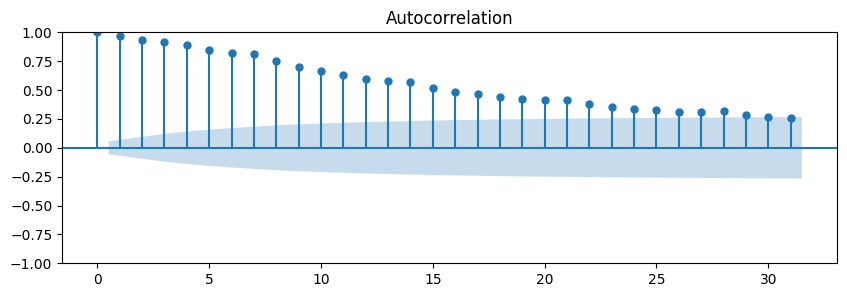

In [38]:
matplotlib.rcParams['figure.figsize']=[10,3]
plot_acf(df_general.new_cases)
plt.show()

In [39]:
pacf_value = pacf(df_general.new_cases, nlags=3)
pacf_value

array([1.        , 0.96735687, 0.01889755, 0.15939683])

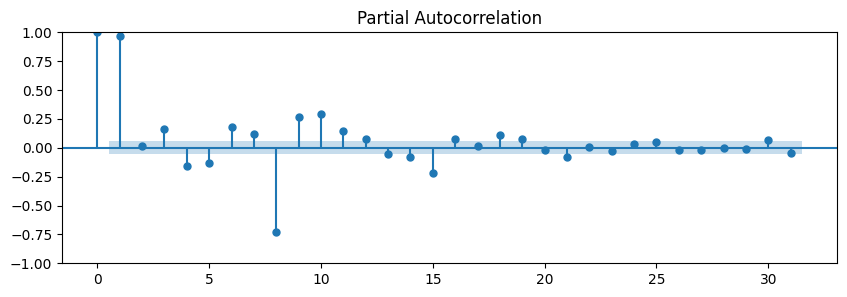

In [40]:
matplotlib.rcParams['figure.figsize']=[10,3]
plot_pacf(df_general.new_cases)
plt.show()

Згідно графіків дані автокорельовані.

# 2. Побудова моделей машинного навчання

# 2.1.1 Побудова моделі Prophet для нових випадків хвороби

### Імпорт даних

In [41]:
trend_df = df_general.copy()

for i in ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']:
    trend_df[i] = trend_df[i].astype(int)
    
trend_df

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0


In [42]:
trend_df[['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']].tail(10)

,new_cases,new_deaths,new_people_vaccinated_smoothed
date,,,
2023-04-30,220023,1896,38352
2023-05-01,116214,327,20978
2023-05-02,49312,225,19309
2023-05-03,60277,313,11036
2023-05-04,71510,252,0
2023-05-05,70211,257,0
2023-05-06,43855,257,0
2023-05-07,184568,2123,0
2023-05-08,59124,213,0


In [43]:
trend_df.shape

(1223, 13)

In [44]:
trend_df.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
count,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1223.000000,1223.000000,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03,1.223000e+03
mean,3.013432e+08,6.262629e+05,6.260957e+05,3.973484e+06,5669.578087,5668.228242,6.024532e+09,2.720935e+09,2.340521e+09,9.098909e+08,1.093207e+07,1.093108e+07,4.048592e+06
std,2.649754e+08,7.903873e+05,7.632848e+05,2.492672e+06,4070.498370,3961.558534,5.601857e+09,2.414702e+09,2.230270e+09,1.132487e+09,1.330365e+07,1.302708e+07,5.602577e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,4.856619e+07,2.368775e+05,2.407710e+05,1.321866e+06,1751.500000,1645.642500,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.207932e+08,4.620450e+05,4.694206e+05,4.618729e+06,5630.000000,5792.000000,5.531856e+09,3.199700e+09,2.201025e+09,2.160832e+07,5.014499e+06,5.531410e+06,1.354674e+06
75%,5.514580e+08,6.652825e+05,6.483359e+05,6.375276e+06,8464.000000,8685.143000,1.214252e+10,5.242831e+09,4.811244e+09,2.142963e+09,1.967606e+07,1.935283e+07,6.857527e+06
max,7.659025e+08,7.460827e+06,6.410668e+06,6.927365e+06,20028.000000,14680.286000,1.337918e+10,5.580601e+09,5.132054e+09,2.763435e+09,4.967335e+07,4.369294e+07,2.107120e+07


In [45]:
plotly_df(trend_df[['new_cases']], title='COVID-19 in the world: new cases per day')

### Створення тренувальної вибірки і підготовка даних для тренування

In [46]:
predictions = 80

In [47]:
train_df = trend_df[:-predictions]
train_df.reset_index(inplace=True)
train_df.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [48]:
train_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1138,2023-02-14,756000500.0,124833,172841.000,6861320.0,748,1408.571,1.329145e+10,5.540396e+09,5.093057e+09,2.733621e+09,1708013.0,1304779.0,518120
1139,2023-02-15,756156652.0,156152,173130.714,6862179.0,859,1415.286,1.329184e+10,5.540427e+09,5.093087e+09,2.733813e+09,1320886.0,1292706.0,525408
1140,2023-02-16,756277897.0,121245,170110.857,6863022.0,843,1288.571,1.329228e+10,5.540478e+09,5.093141e+09,2.734056e+09,1272790.0,1280769.0,530486
1141,2023-02-17,756637218.0,359321,161536.000,6866630.0,3608,1208.000,1.329282e+10,5.540538e+09,5.093190e+09,2.734329e+09,1329509.0,1270183.0,535366


In [49]:
trend_df.corrwith(trend_df["new_cases"])

total_cases                       0.246643
new_cases                         1.000000
new_cases_smoothed                0.944634
total_deaths                      0.351068
new_deaths                        0.186578
new_deaths_smoothed               0.158116
total_vaccinations                0.317906
people_vaccinated                 0.339341
people_fully_vaccinated           0.328420
total_boosters                    0.198846
new_vaccinations                  0.263311
new_vaccinations_smoothed         0.278621
new_people_vaccinated_smoothed    0.120263
dtype: float64

In [50]:
trend_df.reset_index(inplace=True)
trend_df.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)
trend_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
1219,2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
1220,2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0
1221,2023-05-08,765893470.0,59124,76979.571,6927288.0,213,520.000,1.337900e+10,5.580601e+09,5.132054e+09,2.763256e+09,0.0,0.0,0


###  Побудова моделі

### Модель без екзогенних чинників (вакцинування)

In [51]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(train_df)

13:19:13 - cmdstanpy - INFO - Chain [1] start processing
13:19:14 - cmdstanpy - INFO - Chain [1] done processing


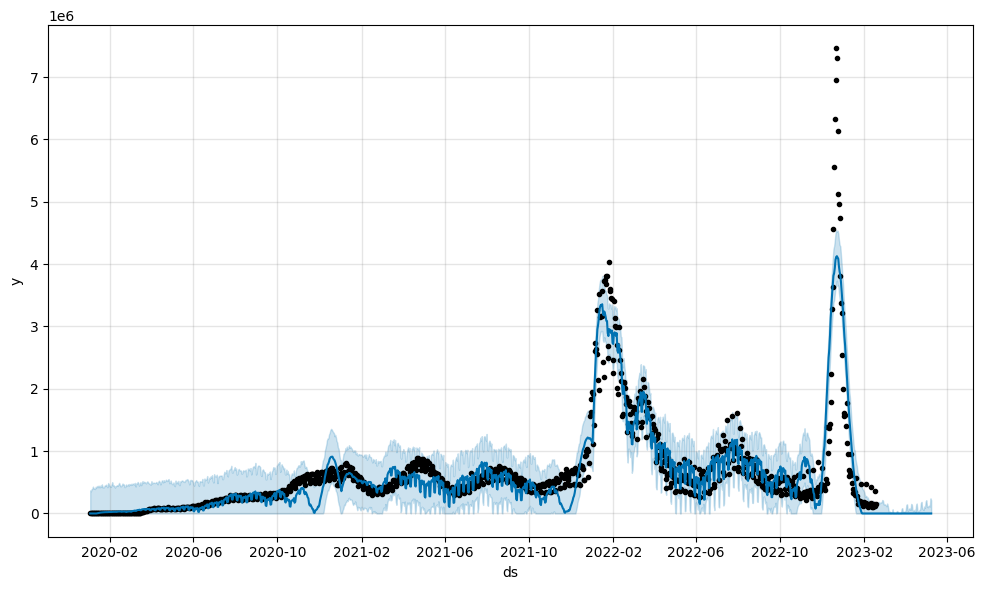

In [52]:
future = m.make_future_dataframe(periods=predictions, freq='D')

forecast_test = m.predict(future)

# Exclude negative values
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)

fig = m.plot(forecast_test)

In [53]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [54]:
trend_df = trend_df.set_index('ds')

In [55]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

### Оцінка якості моделі

In [56]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -0.764
	P-значення = 0.829
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 113889.1
MSE: 17704603918.75
MAPE: 1.0
MPE: 1.0
Стандартна похибка: 133058.6484


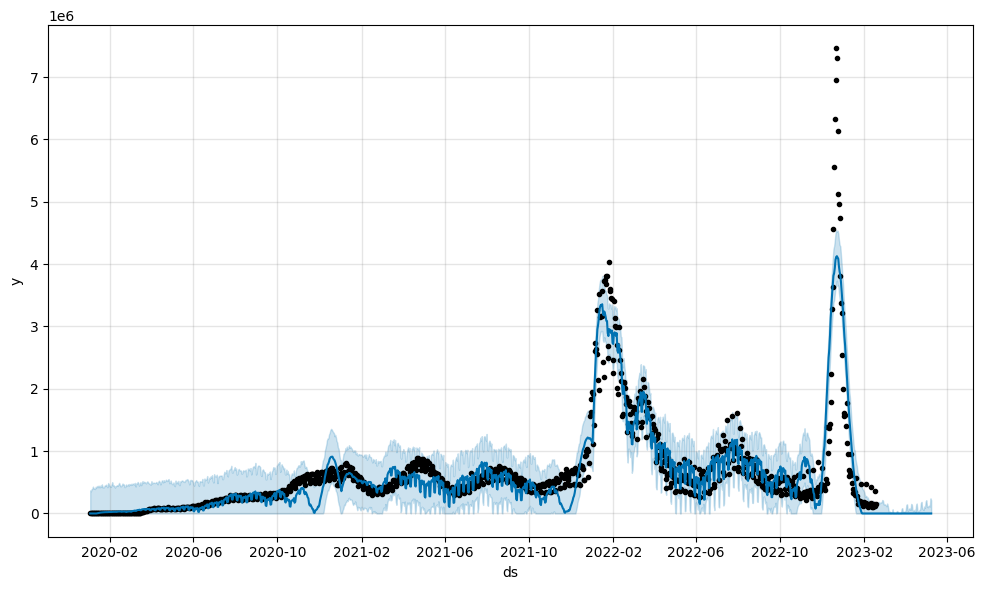

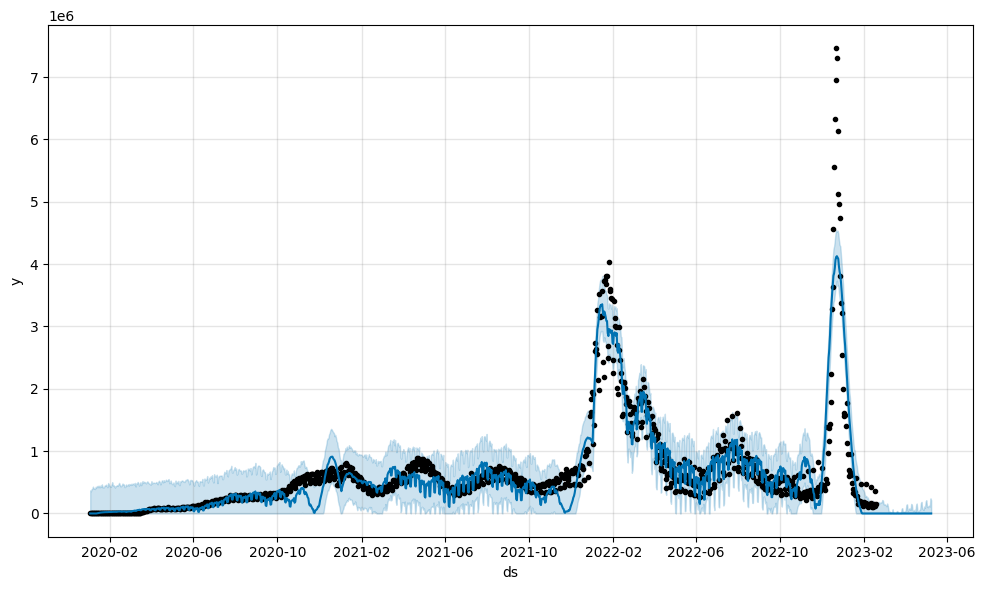

In [57]:
m.plot(forecast_test)

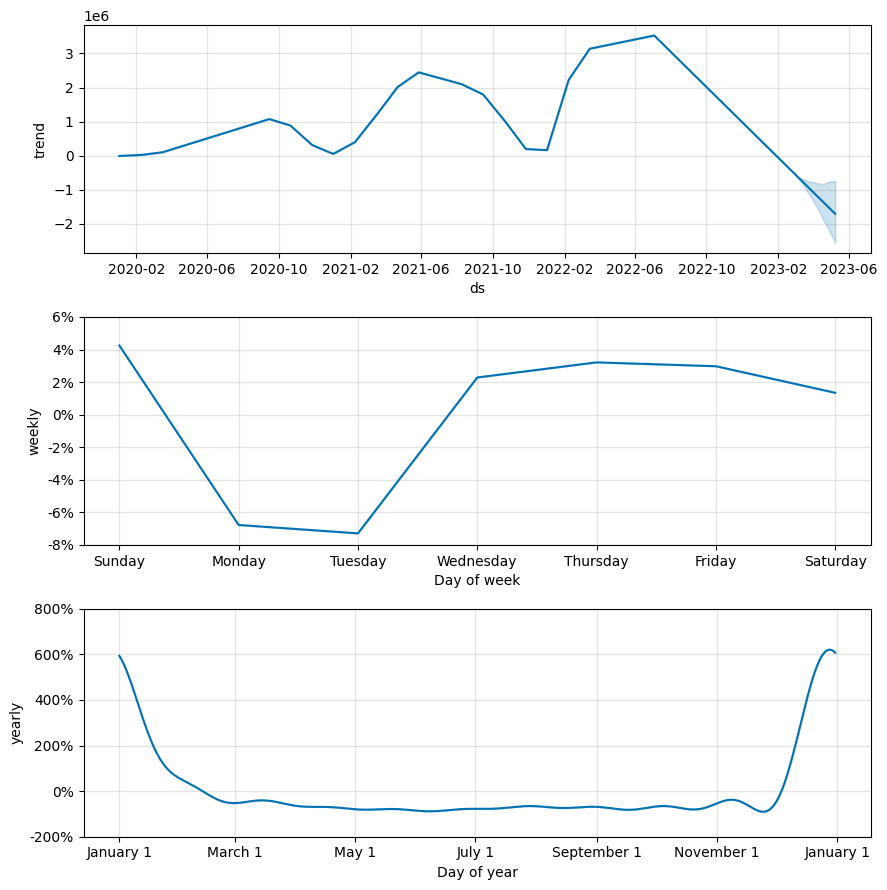

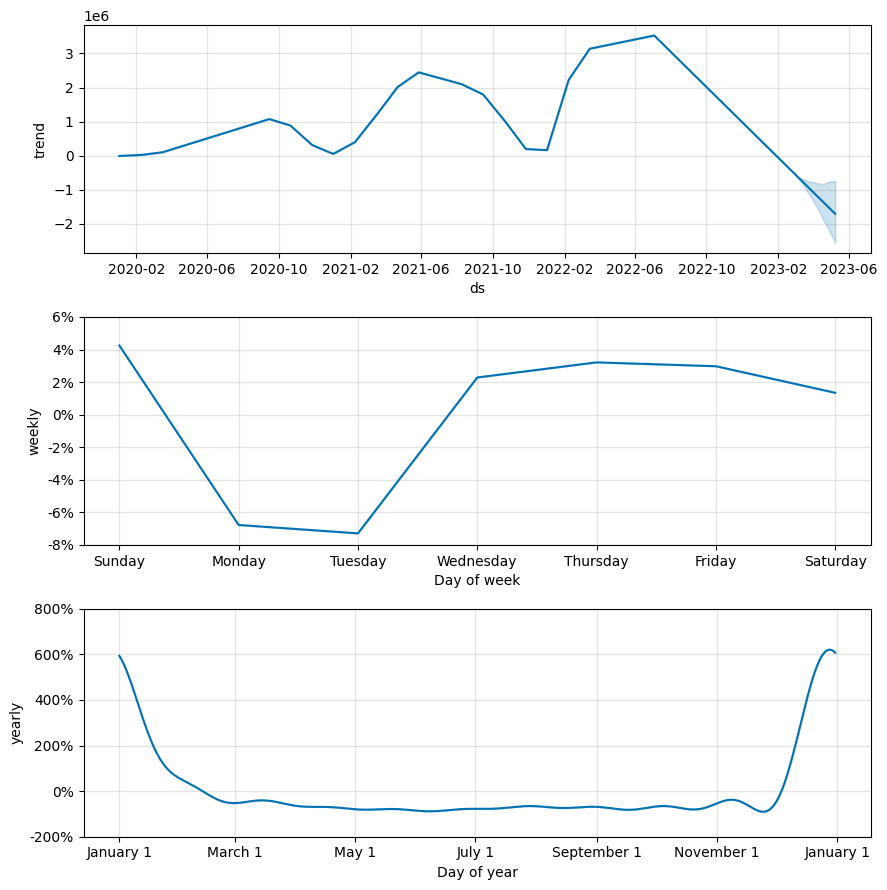

In [58]:
m.plot_components(forecast_test)

### Модель з екзогенними чинниками (вакцинування)

In [59]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

# Add regressor
m.add_regressor('new_people_vaccinated_smoothed', standardize=False)

m.fit(train_df)

13:19:17 - cmdstanpy - INFO - Chain [1] start processing
13:19:17 - cmdstanpy - INFO - Chain [1] done processing
13:19:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Unknown error
Optimization terminated abnormally. Falling back to Newton.
13:19:17 - cmdstanpy - INFO - Chain [1] start processing
13:19:20 - cmdstanpy - INFO - Chain [1] done processing


In [60]:
trend_df.reset_index(inplace=True)

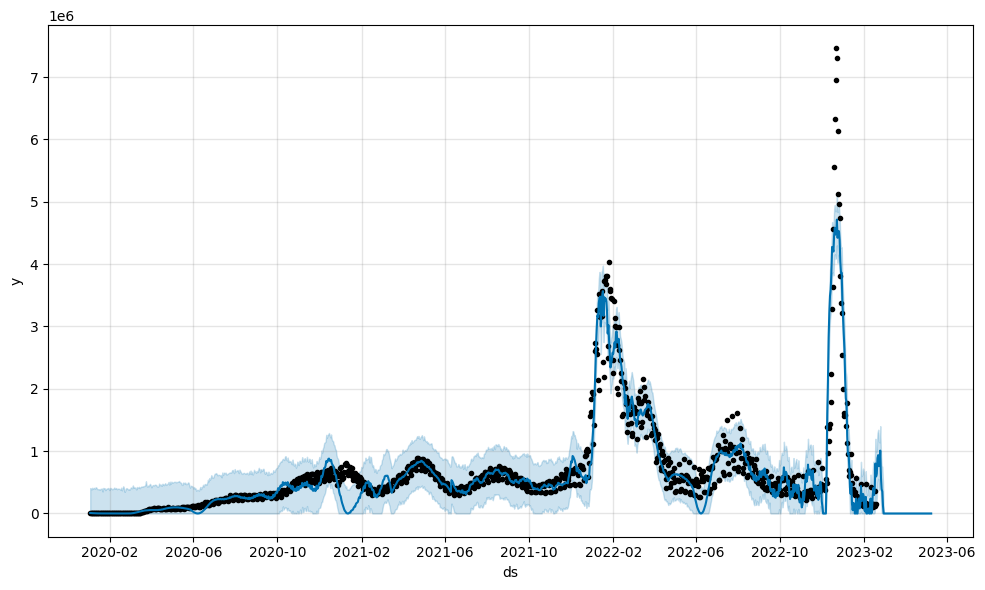

In [61]:
future = m.make_future_dataframe(periods=predictions, freq='D')

# Append the regressor values
future = pd.merge(future, trend_df[['ds', 'new_people_vaccinated_smoothed']], on='ds', how='inner')

# Fill the missing values with the previous value
future = future.fillna(method='ffill')

forecast_test = m.predict(future)

# Exclude negative values
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)
    
    
fig = m.plot(forecast_test)

In [62]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [63]:
trend_df = trend_df.set_index('ds')

In [64]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

### Оцінка якості моделі

In [65]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -8.843
	P-значення = 0.000
Критичне значення :
	1%: -3.526004646825607 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.9032002348069774 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5889948363419957 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 158610.4644
MSE: 56401816793.6522
MAPE: 1.4262
MPE: 0.3238
Стандартна похибка: 237490.6668


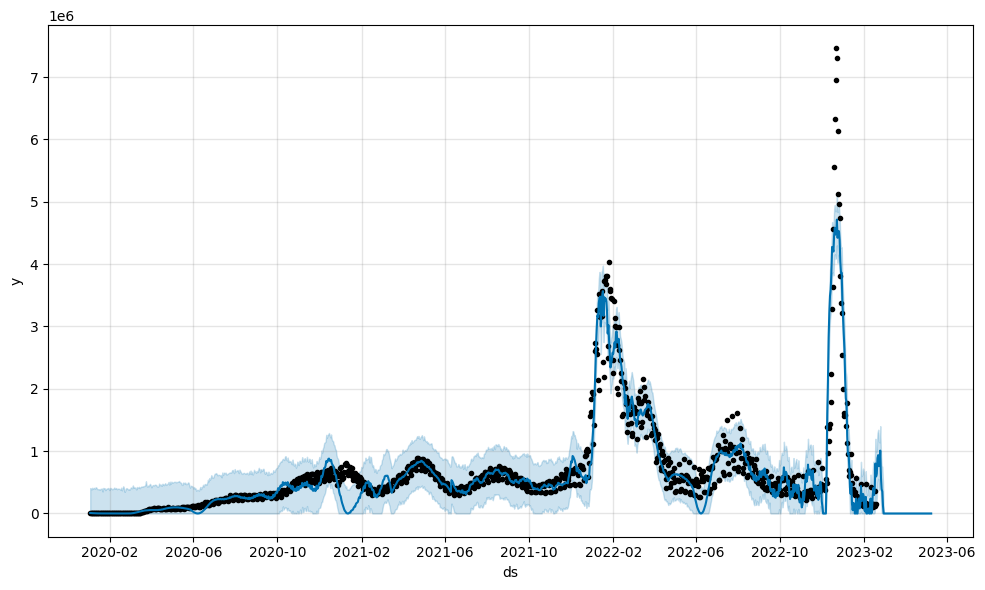

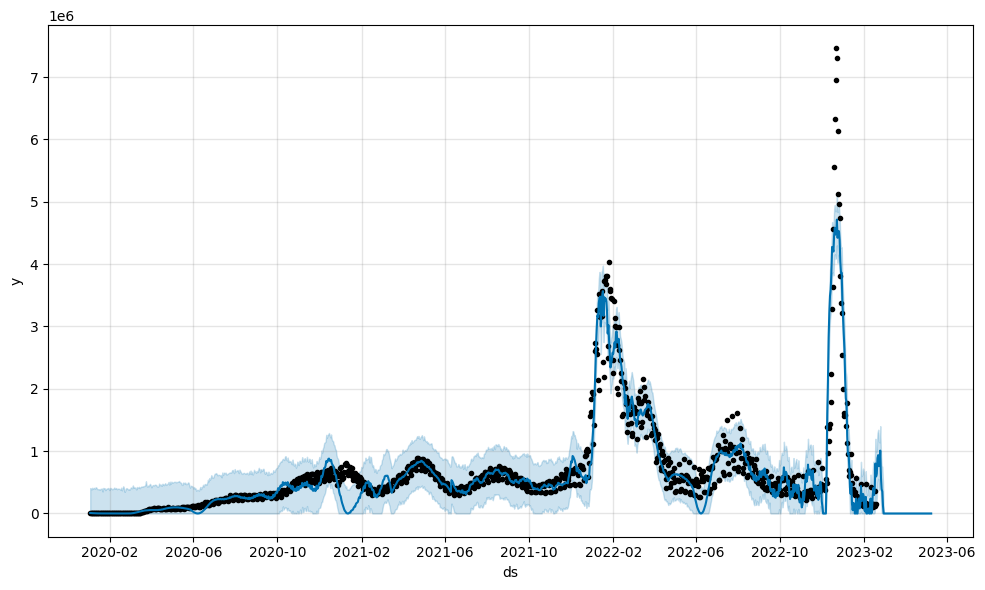

In [66]:
m.plot(forecast_test)

# Прогноз

In [67]:
predict_df = trend_df.copy()
predict_df.reset_index(inplace=True)

predict_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
1219,2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
1220,2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0
1221,2023-05-08,765893470.0,59124,76979.571,6927288.0,213,520.000,1.337900e+10,5.580601e+09,5.132054e+09,2.763256e+09,0.0,0.0,0


In [68]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(predict_df)

13:19:22 - cmdstanpy - INFO - Chain [1] start processing
13:19:24 - cmdstanpy - INFO - Chain [1] done processing


In [69]:
trend_df.reset_index(inplace=True)

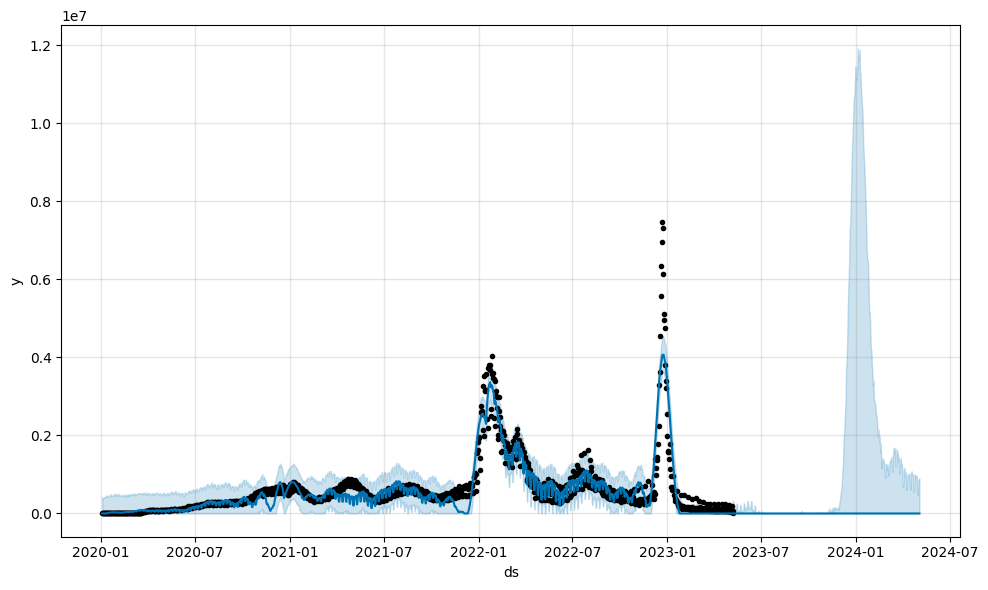

In [70]:
future = m.make_future_dataframe(periods=360)

forecast = m.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast[col] = forecast[col].clip(lower=0.0)
    
fig = m.plot(forecast)

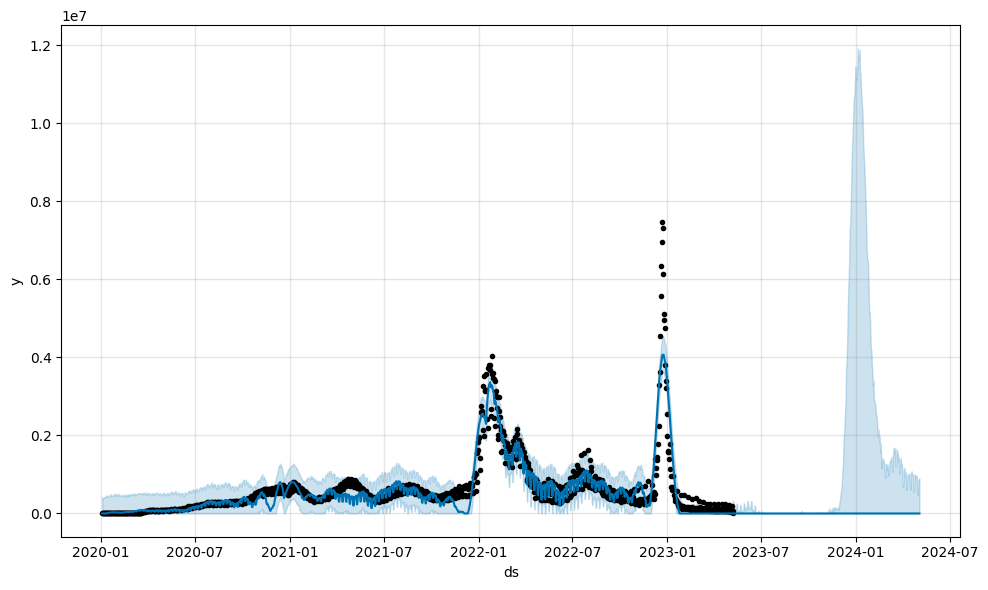

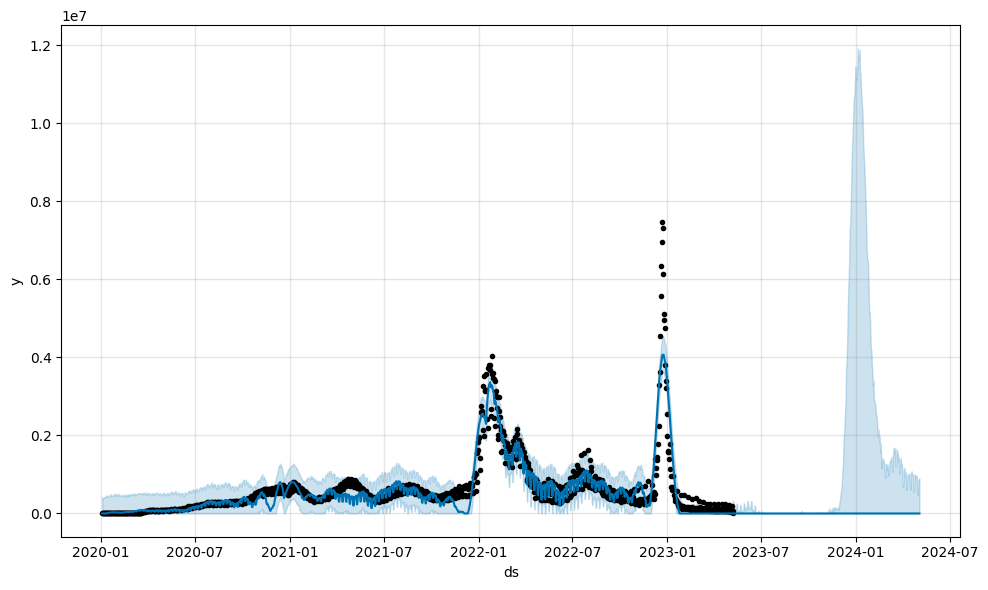

In [71]:
m.plot(forecast)

In [72]:
forecast[['ds', 'yhat_upper', 'yhat', 'yhat_lower']].tail(60)

,ds,yhat_upper,yhat,yhat_lower
1523,2024-03-05,1.083408e+06,0.0,0.0
1524,2024-03-06,1.247955e+06,0.0,0.0
1525,2024-03-07,1.353221e+06,0.0,0.0
1526,2024-03-08,1.378235e+06,0.0,0.0
1527,2024-03-09,1.356851e+06,0.0,0.0
1528,2024-03-10,1.448308e+06,0.0,0.0
1529,2024-03-11,1.109946e+06,0.0,0.0
1530,2024-03-12,1.071550e+06,0.0,0.0
1531,2024-03-13,1.498531e+06,0.0,0.0
1532,2024-03-14,1.684097e+06,0.0,0.0


In [73]:
forecast.to_csv('forecast_new_cases_prophet.csv')

# 2.1.2 Побудова моделі Prophet для смертності внаслідок хвороби

In [74]:
trend_df = df_general.copy()

for i in ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']:
    trend_df[i] = trend_df[i].astype(int)
    
trend_df

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0


In [75]:
predictions = 80

train_df = trend_df[:-predictions]

train_df.reset_index(inplace=True)

train_df.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)


trend_df.corrwith(trend_df["new_deaths"])


total_cases                      -0.503210
new_cases                         0.186578
new_cases_smoothed                0.185915
total_deaths                     -0.281135
new_deaths                        1.000000
new_deaths_smoothed               0.971326
total_vaccinations               -0.512749
people_vaccinated                -0.463289
people_fully_vaccinated          -0.513317
total_boosters                   -0.627277
new_vaccinations                  0.435412
new_vaccinations_smoothed         0.428810
new_people_vaccinated_smoothed    0.462339
dtype: float64

In [76]:
train_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1138,2023-02-14,756000500.0,124833,172841.000,6861320.0,748,1408.571,1.329145e+10,5.540396e+09,5.093057e+09,2.733621e+09,1708013.0,1304779.0,518120
1139,2023-02-15,756156652.0,156152,173130.714,6862179.0,859,1415.286,1.329184e+10,5.540427e+09,5.093087e+09,2.733813e+09,1320886.0,1292706.0,525408
1140,2023-02-16,756277897.0,121245,170110.857,6863022.0,843,1288.571,1.329228e+10,5.540478e+09,5.093141e+09,2.734056e+09,1272790.0,1280769.0,530486
1141,2023-02-17,756637218.0,359321,161536.000,6866630.0,3608,1208.000,1.329282e+10,5.540538e+09,5.093190e+09,2.734329e+09,1329509.0,1270183.0,535366


In [77]:
trend_df.reset_index(inplace=True)
trend_df.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)
trend_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
1219,2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
1220,2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0
1221,2023-05-08,765893470.0,59124,76979.571,6927288.0,213,520.000,1.337900e+10,5.580601e+09,5.132054e+09,2.763256e+09,0.0,0.0,0


### Модель без екзогенних чинників (вакцинування)

In [78]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(train_df)

13:19:25 - cmdstanpy - INFO - Chain [1] start processing
13:19:26 - cmdstanpy - INFO - Chain [1] done processing


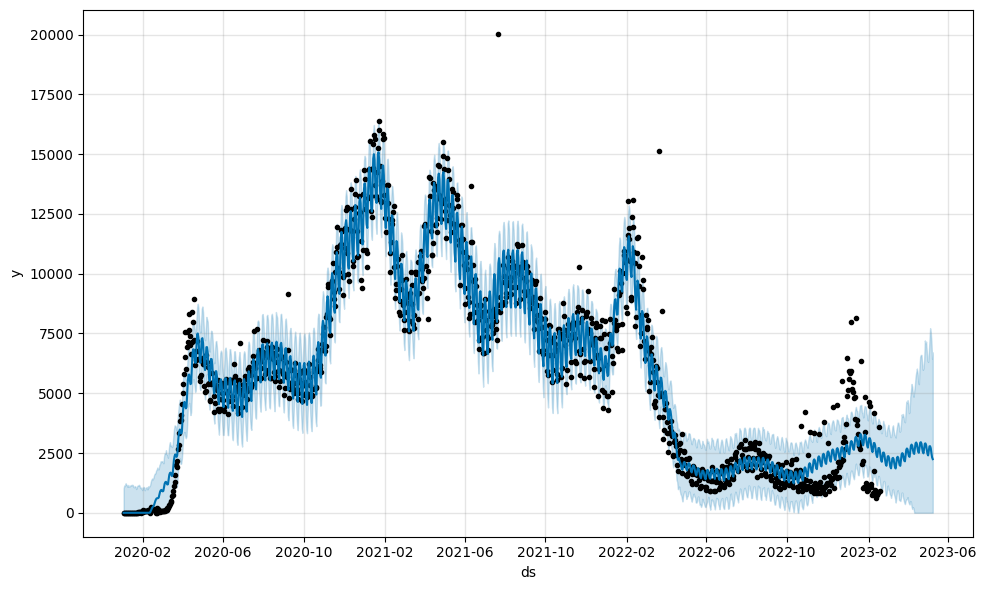

In [79]:
future = m.make_future_dataframe(periods=predictions, freq='D')

forecast_test = m.predict(future)

# Виключаємо від'ємні значення
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)

fig = m.plot(forecast_test)

In [80]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [81]:
trend_df = trend_df.set_index('ds')

In [82]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

In [83]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -0.472
	P-значення = 0.897
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 1724.902
MSE: 3408393.1466
MAPE: 4.3265
MPE: -4.3012
Стандартна похибка: 1846.1834


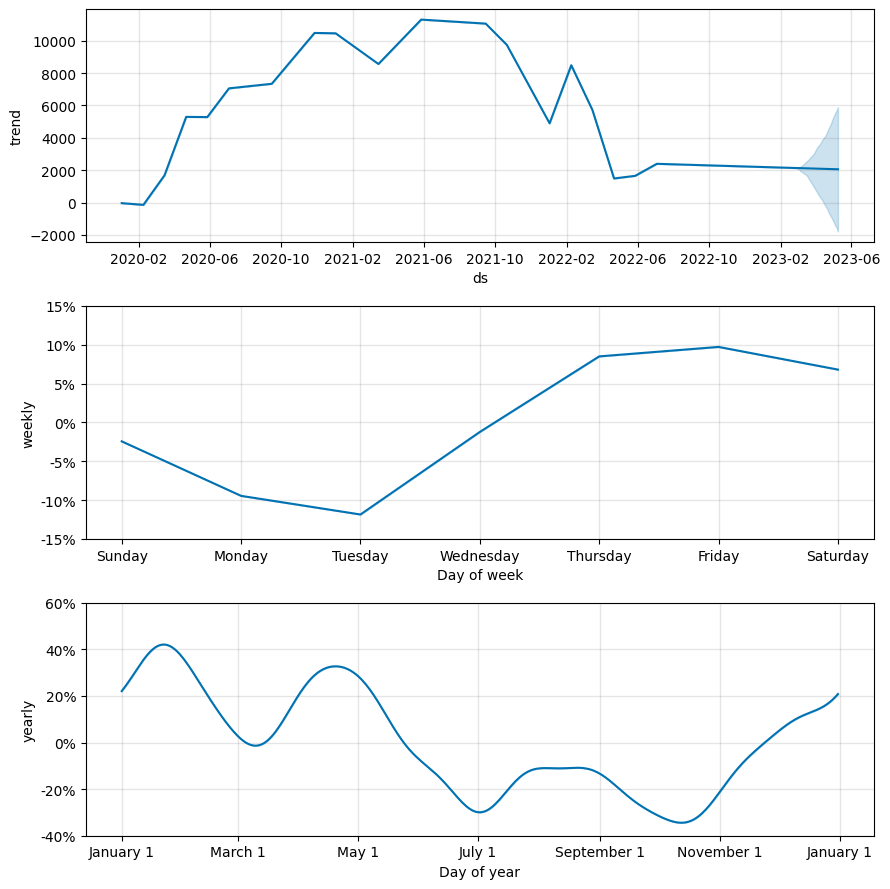

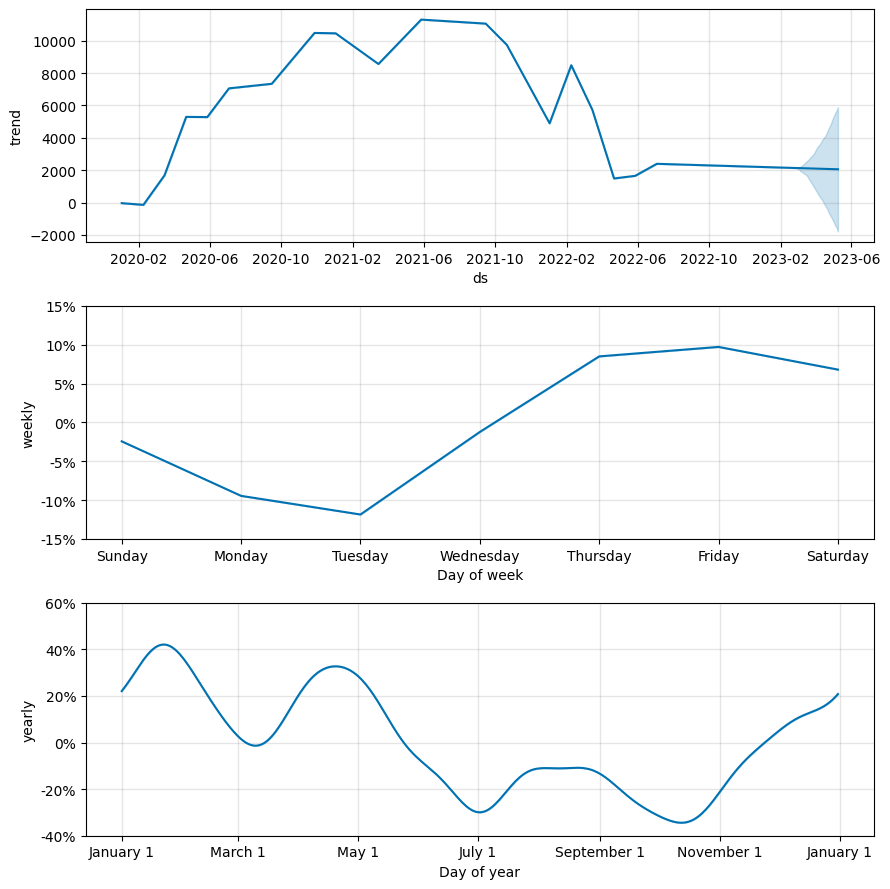

In [84]:
m.plot_components(forecast_test)

### Модель з екзогенними чинниками (вакцинування)

In [85]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

# Add regressor
m.add_regressor('new_people_vaccinated_smoothed', standardize=False)

m.fit(train_df)

13:19:28 - cmdstanpy - INFO - Chain [1] start processing
13:19:28 - cmdstanpy - INFO - Chain [1] done processing
13:19:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Unknown error
Optimization terminated abnormally. Falling back to Newton.
13:19:28 - cmdstanpy - INFO - Chain [1] start processing
13:19:37 - cmdstanpy - INFO - Chain [1] done processing


In [86]:
trend_df.reset_index(inplace=True)

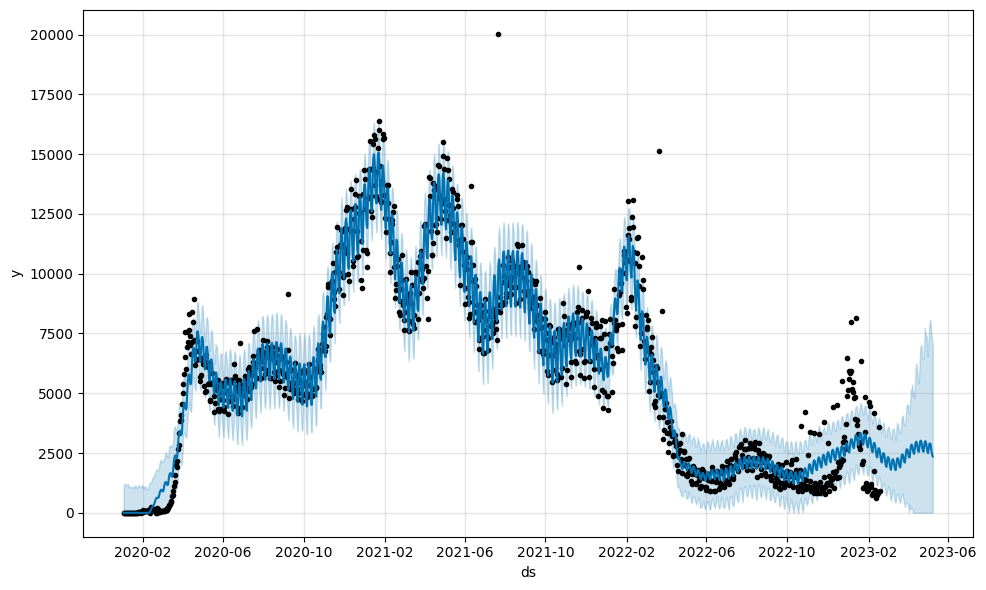

In [87]:
future = m.make_future_dataframe(periods=predictions, freq='D')

# Append the regressor values
future = pd.merge(future, trend_df[['ds', 'new_people_vaccinated_smoothed']], on='ds', how='inner')

forecast_test = m.predict(future)

# Exclude negative values
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)

fig = m.plot(forecast_test)

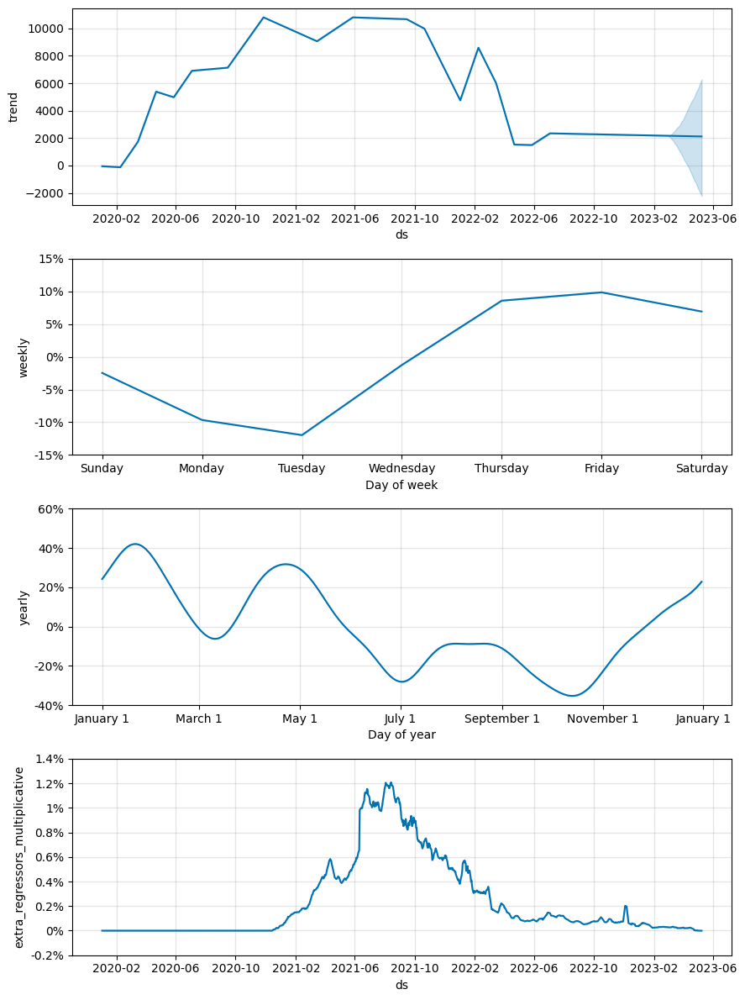

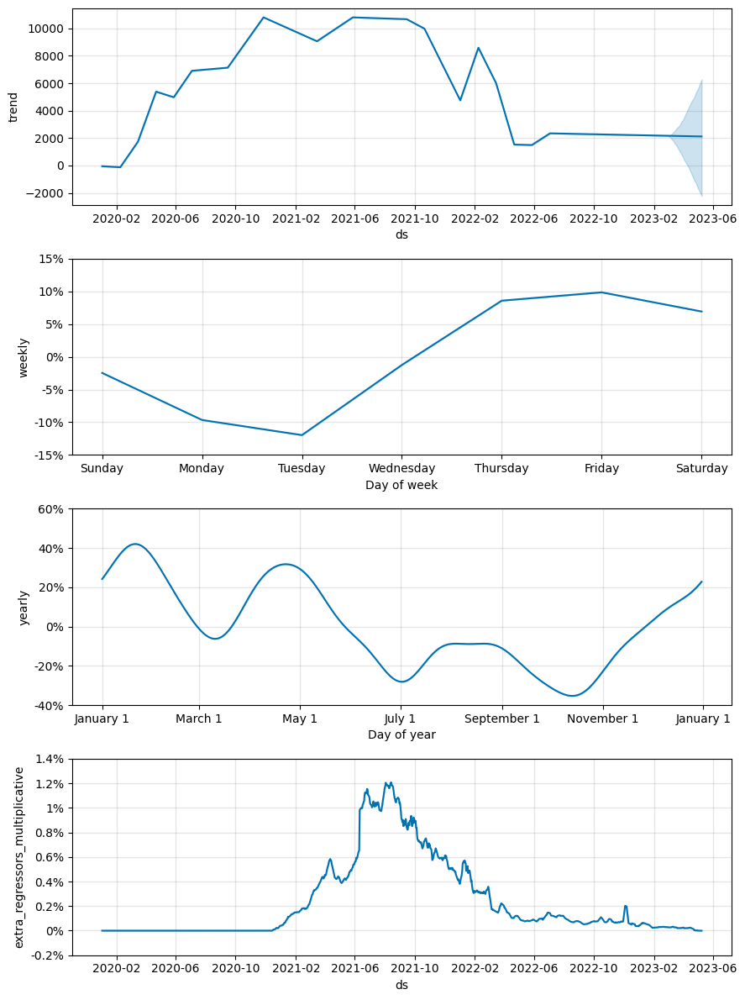

In [88]:
m.plot_components(forecast_test)

In [89]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [90]:
trend_df = trend_df.set_index('ds')

In [91]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

In [92]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -0.178
	P-значення = 0.941
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 1729.3018
MSE: 3446124.8815
MAPE: 4.3765
MPE: -4.349
Стандартна похибка: 1856.3741


# Прогноз

In [93]:
predict_df = trend_df.copy()
predict_df.reset_index(inplace=True)

predict_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,2023-05-05,765605923.0,70211,92974.571,6924696.0,257,495.000,1.337891e+10,5.580595e+09,5.132039e+09,2.763192e+09,0.0,0.0,0
1219,2023-05-06,765649778.0,43855,90200.286,6924953.0,257,503.857,1.337897e+10,5.580599e+09,5.132043e+09,2.763241e+09,0.0,0.0,0
1220,2023-05-07,765834346.0,184568,85135.286,6927075.0,2123,536.286,1.337898e+10,5.580600e+09,5.132047e+09,2.763248e+09,0.0,0.0,0
1221,2023-05-08,765893470.0,59124,76979.571,6927288.0,213,520.000,1.337900e+10,5.580601e+09,5.132054e+09,2.763256e+09,0.0,0.0,0


In [94]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(predict_df)

13:19:39 - cmdstanpy - INFO - Chain [1] start processing
13:19:40 - cmdstanpy - INFO - Chain [1] done processing


In [95]:
trend_df.reset_index(inplace=True)

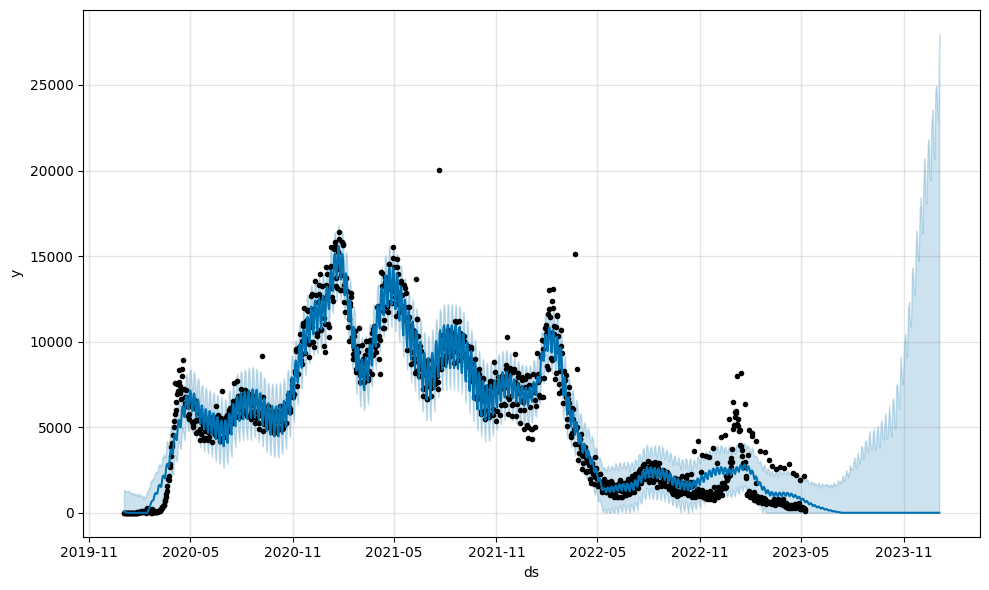

In [96]:
future = m.make_future_dataframe(periods=240)

forecast = m.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast[col] = forecast[col].clip(lower=0.0)
    
fig = m.plot(forecast)

# 2.2 Побудова моделі SARIMAX

In [97]:
def sesonal(data, s):
    plt.figure(figsize=(19,8), dpi= 80)
    for i, y in enumerate(data.index.year.unique()):
        plt.plot(list(range(1,len(data[data.index.year==y])+1)), data[data.index.year==y][data.columns[0]].values, label=y)
    plt.title("Сезонність по періодам")
    plt.legend(loc="best")
    plt.show()

### Без екзогенних чинників (вакцинування)

In [98]:
df_case = df_general[['new_cases']].copy()

In [99]:
df_case.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1223 entries, 2020-01-03 to 2023-05-09
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   new_cases  1223 non-null   float64
dtypes: float64(1)
memory usage: 19.1 KB


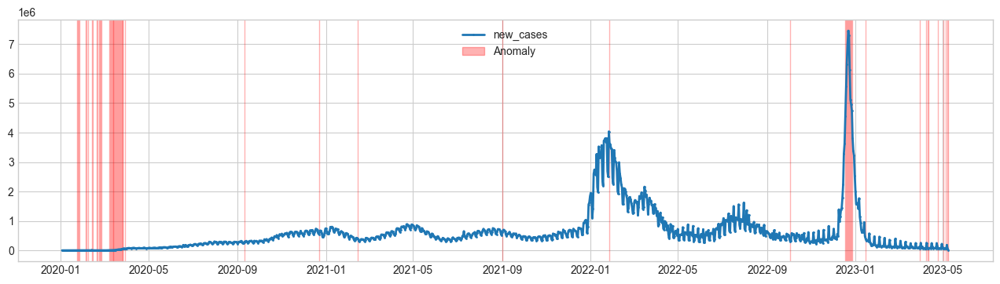

In [100]:
outlier_detector = OutlierDetector(LocalOutlierFactor(contamination=0.05))
anomalies = outlier_detector.fit_detect(df_case)
plot(df_case, anomaly=anomalies, ts_linewidth=2, anomaly_color='red', anomaly_alpha=0.3, curve_group='all');

In [101]:
anomalies[anomalies]

date
2020-01-24    True
2020-01-25    True
2020-01-26    True
2020-01-27    True
2020-02-05    True
              ... 
2023-04-25    True
2023-05-02    True
2023-05-06    True
2023-05-08    True
2023-05-09    True
Length: 62, dtype: bool

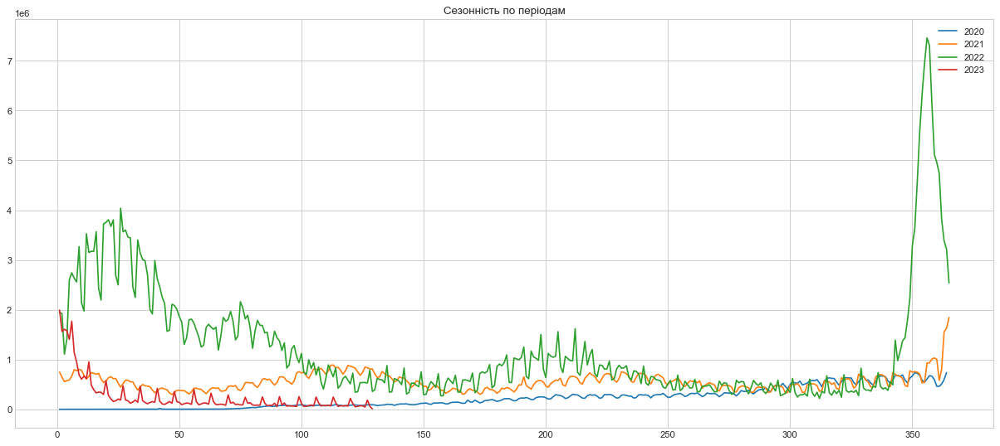

In [102]:
sesonal(df_case,12)

Text(0.5, 0.98, 'Адитивна модель')

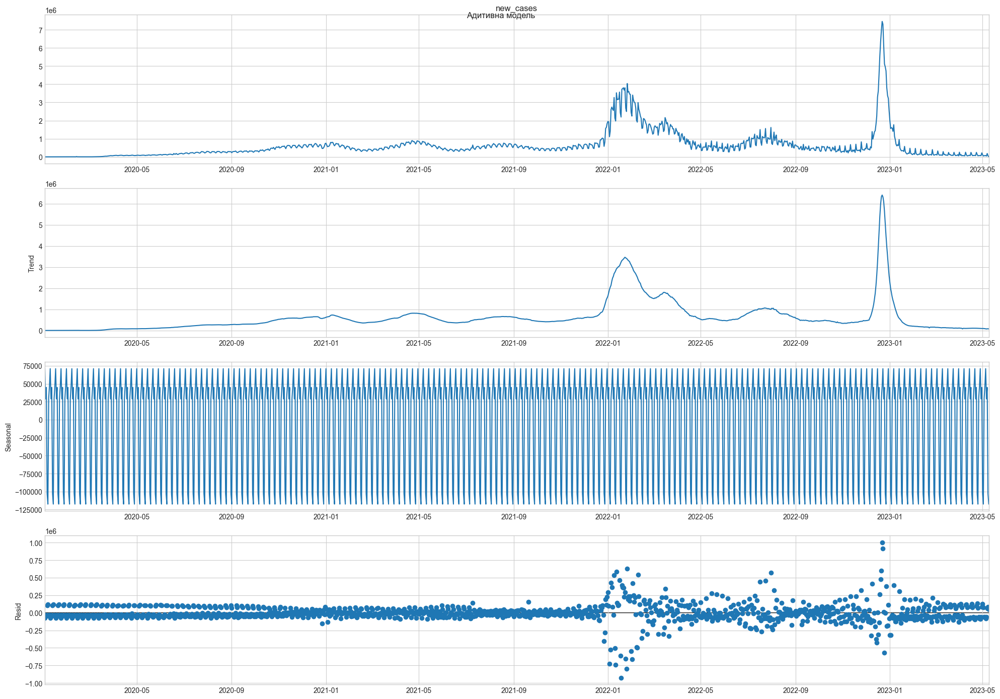

In [103]:
# Decompose 
result_A = seasonal_decompose(df_case.new_cases, model='additive', extrapolate_trend=12)

# Plot
plt.rcParams.update({'figure.figsize': (20,14)})
result_A.plot().suptitle('Адитивна модель')

In [104]:
df_case['new_cases'] = df_case['new_cases'].astype(int)

### Підготовка тренувальної та тестової вибірок

In [105]:
prediction = 80

In [106]:
train=df_case[:-prediction]

In [107]:
test=df_case[-prediction:]

Для того, щоб модель прогнозувала лише невід'ємні значення, виконаємо попередню трансформацію даних за допомогою Yeo-Johnson.

In [108]:
from pmdarima.arima import auto_arima
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.preprocessing import PowerTransformer

## Yeo-Johnson

In [109]:
transformer = PowerTransformer()
train['new_cases'] = transformer.fit_transform(train[['new_cases']])
test['new_cases'] = transformer.transform(test[['new_cases']])

In [110]:
model = auto_arima(train['new_cases'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)
model

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-488.291, Time=2.70 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=-220.694, Time=0.08 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=-385.877, Time=0.48 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-447.305, Time=0.50 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=-222.632, Time=0.05 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-446.558, Time=2.19 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-432.011, Time=2.10 sec
 ARIMA(2,1,2)(2,0,1)[12] intercept   : AIC=-472.734, Time=6.47 sec
 ARIMA(2,1,2)(1,0,2)[12] intercept   : AIC=-510.896, Time=6.97 sec
 ARIMA(2,1,2)(0,0,2)[12] intercept   : AIC=-492.002, Time=6.06 sec
 ARIMA(2,1,2)(2,0,2)[12] intercept   : AIC=-490.792, Time=7.19 sec
 ARIMA(1,1,2)(1,0,2)[12] intercept   : AIC=-522.696, Time=6.87 sec
 ARIMA(1,1,2)(0,0,2)[12] intercept   : AIC=-489.254, Time=5.59 sec
 ARIMA(1,1,2)(1,0,1)[12] intercept   : AIC=-478.389, Time=2.37 sec
 ARIMA(1,1,2)(2,0,2

ARIMA(order=(2, 1, 3), scoring_args={}, seasonal_order=(0, 0, 0, 12),
      suppress_warnings=True, with_intercept=False)

In [111]:
order = model.order

seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(train['new_cases'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

results = model_sarimax.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4389      0.004   -119.670      0.000      -0.446      -0.432
ar.L2         -0.9933      0.004   -262.564      0.000      -1.001      -0.986
ma.L1          0.2723      0.023     11.762      0.000       0.227       0.318
ma.L2          1.0284      0.017     62.230      0.000       0.996       1.061
ma.L3         -0.1470      0.026     -5.755      0.000      -0.197      -0.097
sigma2         0.0277      0.001     25.445      0.000       0.026       0.030


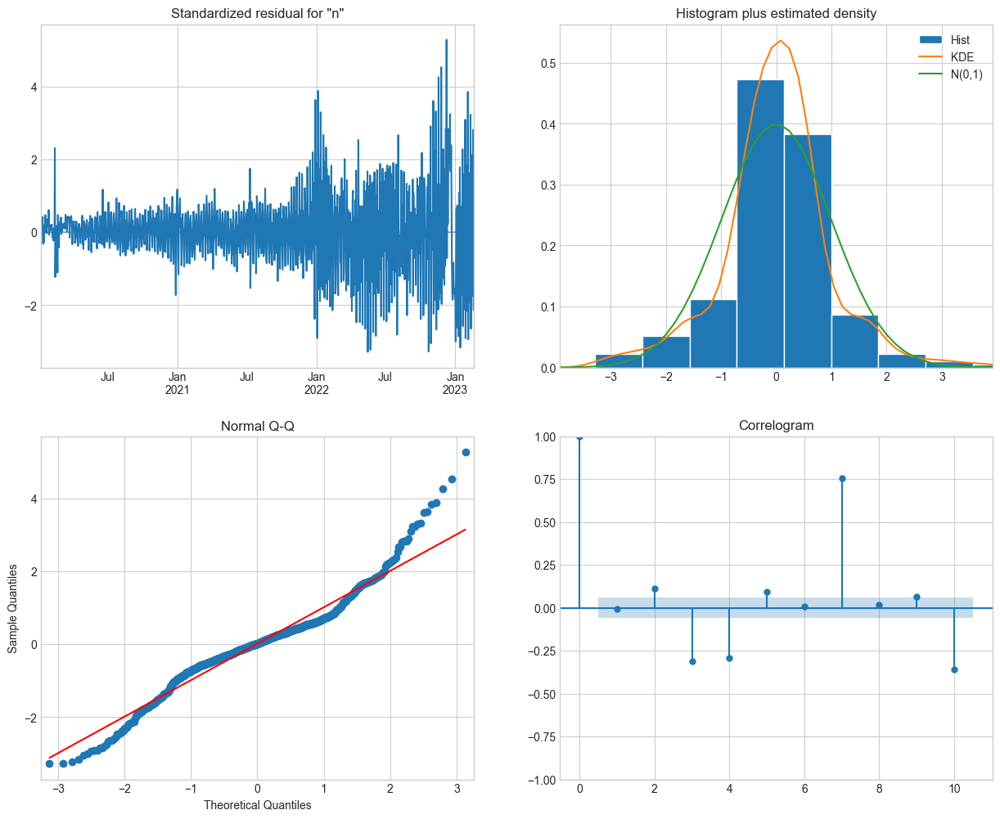

In [112]:
results.plot_diagnostics(figsize=(15, 12))
results = model_sarimax.fit()
plt.show()

In [113]:
pred = results.get_prediction(start=test.index[0], end=test.index[-1])
pred_transformed = pred.predicted_mean.to_numpy().reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

In [114]:
metrics(test['new_cases'], pred)

Тест на стаціонарність:
	T-статистика = -2.286
	P-значення = 0.177
Критичне значення :
	1%: -3.530398990560757 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9050874099328317 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5900010121107266 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 170460.4472
MSE: 29854919560.3386
MAPE: -194729.5115
MPE: 194729.5115
Стандартна похибка: 172785.762


# Прогноз

In [115]:
concatenated_df = pd.concat([train['new_cases'], test['new_cases']])

In [116]:
model = auto_arima(concatenated_df,
                   seasonal=True,
                   m=12,
                   suppress_warnings=True,
                   error_action='ignore')
model

ARIMA(order=(5, 1, 5), scoring_args={}, seasonal_order=(2, 0, 0, 12),
      suppress_warnings=True, with_intercept=False)

In [117]:
order = model.order

seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(concatenated_df,
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

results = model_sarimax.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1817      0.039      4.632      0.000       0.105       0.259
ar.L2         -0.9288      0.033    -28.516      0.000      -0.993      -0.865
ar.L3         -0.1098      0.057     -1.928      0.054      -0.221       0.002
ar.L4         -0.4774      0.032    -14.961      0.000      -0.540      -0.415
ar.L5         -0.6209      0.039    -16.054      0.000      -0.697      -0.545
ma.L1         -0.6957      0.041    -16.863      0.000      -0.777      -0.615
ma.L2          1.2205      0.049     24.840      0.000       1.124       1.317
ma.L3         -0.4258      0.071     -6.004      0.000      -0.565      -0.287
ma.L4          0.6028      0.044     13.640      0.000       0.516       0.689
ma.L5          0.0912      0.037      2.456      0.014       0.018       0.164
ar.S.L12       0.2036      0.019     10.765      0.0

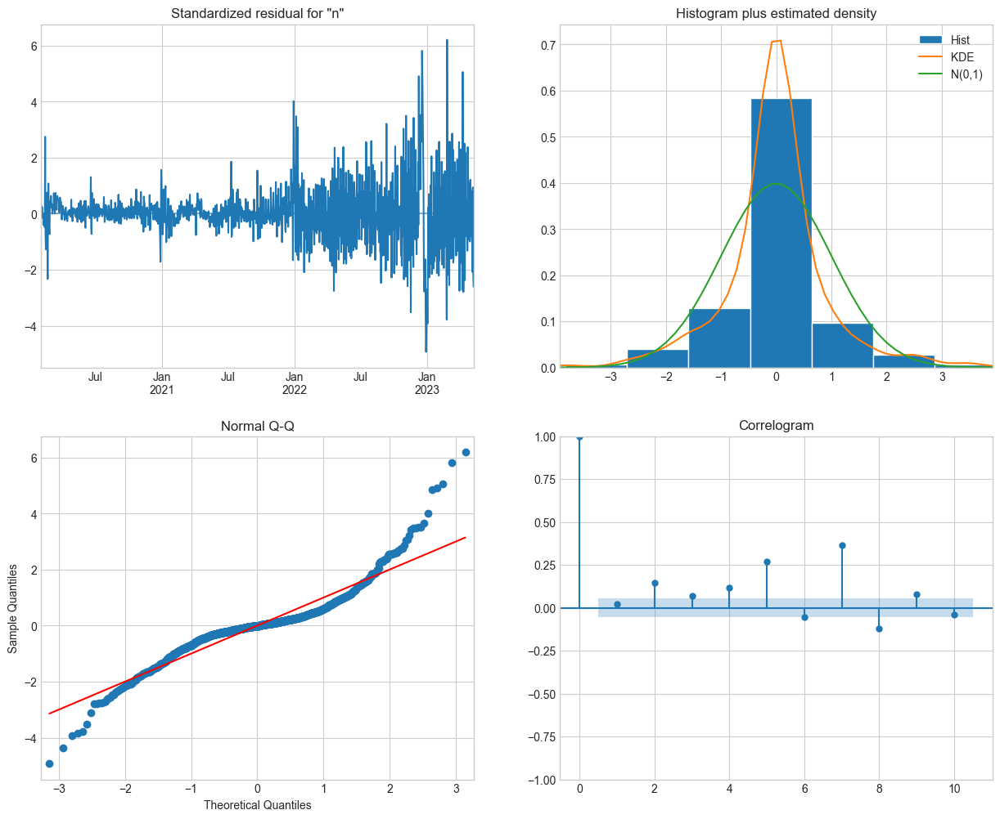

In [118]:
results.plot_diagnostics(figsize=(15, 12))
results = model_sarimax.fit()
plt.show()

In [119]:
start = pd.to_datetime('2023-01-01')
end = pd.to_datetime('2024-01-01') - pd.offsets.DateOffset(days=1)
pred = results.get_prediction(start=start, end=end)
pred = transformer.inverse_transform(pred.predicted_mean.to_numpy().reshape(-1, 1))
pred = pred.flatten()

In [120]:
train['new_cases_original'] = transformer.inverse_transform(train[['new_cases']])

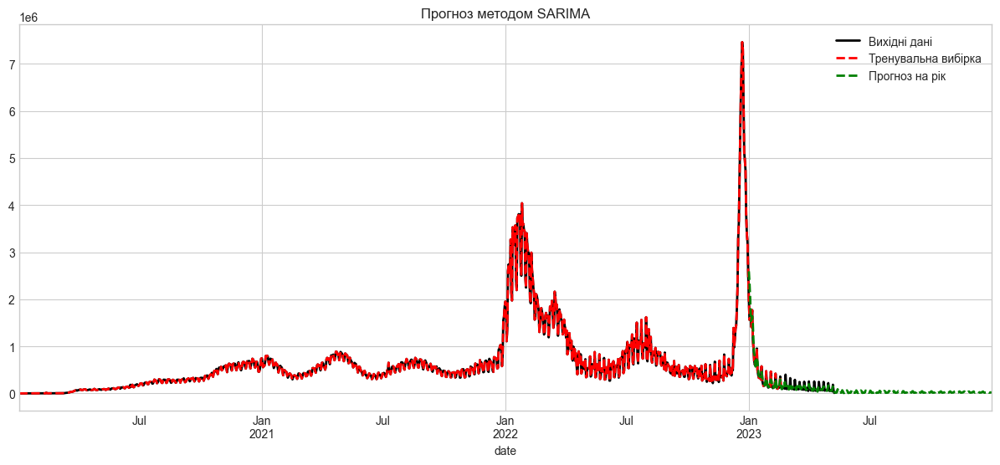

In [122]:
fig, ax = plt.subplots(figsize=(15,6))
df_case.plot(ax=ax, color='black', title="Прогноз методом SARIMA", linewidth = 2)
train['new_cases_original'].plot(ax=ax, style='--', color='red', linewidth = 2)
pred_series = pd.Series(pred, index=pd.date_range(start, end))
pred_series.plot(ax=ax, style='--', color='green', linewidth = 2)
plt.legend(['Вихідні дані', 'Тренувальна вибірка', 'Прогноз на рік'])
plt.show()

In [123]:
pred_series

2023-01-01    2.592833e+06
2023-01-02    2.343335e+06
2023-01-03    2.014635e+06
2023-01-04    1.538758e+06
2023-01-05    1.573427e+06
                  ...     
2023-12-27    1.513715e+04
2023-12-28    1.753646e+04
2023-12-29    1.864222e+04
2023-12-30    2.017048e+04
2023-12-31    3.261081e+04
Freq: D, Length: 365, dtype: float64

## SARIMAX з NNLS (non-negative least squares) алгоритмом для невід'ємних значень з екзогенними чинниками (вакцинування)

In [124]:
from scipy.optimize import nnls

In [125]:
df_case = df_general[['new_cases', 'new_people_vaccinated_smoothed']].copy()

In [126]:
prediction = 80

In [127]:
train=df_case[:-prediction]
test=df_case[-prediction:]

In [128]:
model = auto_arima(train['new_cases'],
                   exogenous=train[['new_people_vaccinated_smoothed']],
                   seasonal=True,
                   m=12,
                   suppress_warnings=True,
                   error_action='ignore')

# Build a SARIMAX model with exogenous features
model_sarimax = SARIMAX(train['new_cases'], exog=train[['new_people_vaccinated_smoothed']],
                        order=model.order,
                        seasonal_order=model.seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

# Fit the model to the data
results = model_sarimax.fit()

# Extract the estimated parameters from the model
params = results.params

# Imposing non-negative constraint using NNLS
X = model_sarimax.exog
y = model_sarimax.endog

                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
new_people_vaccinated_smoothed     0.0071      0.024      0.294      0.769      -0.040       0.054
ar.L1                             -0.6201      0.038    -16.506      0.000      -0.694      -0.547
ar.L2                             -1.0541      0.017    -60.687      0.000      -1.088      -1.020
ar.L3                             -0.1624      0.038     -4.292      0.000      -0.237      -0.088
ma.L1                              0.6997      0.031     22.353      0.000       0.638       0.761
ma.L2                              1.4516      0.022     65.818      0.000       1.408       1.495
ma.L3                              0.4939      0.032     15.526      0.000       0.432       0.556
ma.L4                              0.5722      0.019     29.901      0.000       0.535       0.610
ar.S.L12  

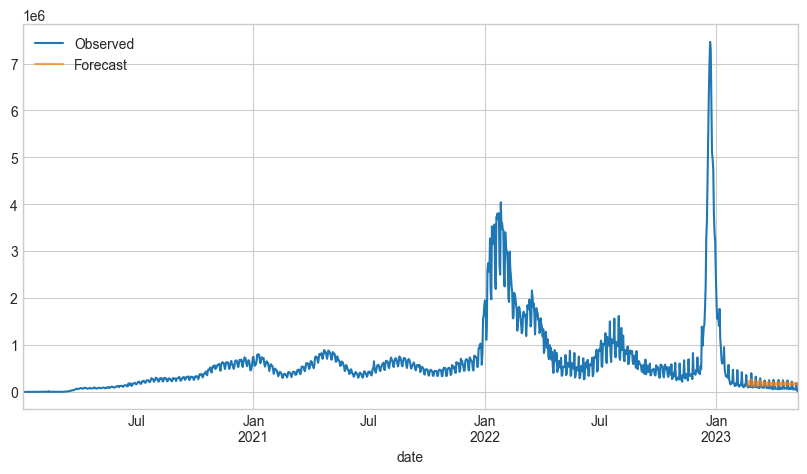

Тест на стаціонарність:
	T-статистика = -0.651
	P-значення = 0.859
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 90037.9491
MSE: 10148239344.7675
MAPE: 1.244
MPE: -1.125
Стандартна похибка: 100738.47


In [129]:
nnls_params, _ = nnls(X, y.ravel())

# Make predictions on the test set
pred = results.get_prediction(start=test.index[0], end=test.index[-1],
                              exog=test[['new_people_vaccinated_smoothed']])

# Enforce non-negativity constraint on the predicted values
pred.predicted_mean = np.maximum(0, pred.predicted_mean)

# Print the summary of the fitted model with non-negative parameters
print(results.summary().tables[1])

data = df_case.reset_index()

# Plot the predicted values and the actual values
ax = data.plot(x='date', y='new_cases', label='Observed', figsize=(10, 5))
pred.predicted_mean.plot(ax=ax, label='Forecast', alpha=.7)
plt.legend()
plt.show()

metrics(test['new_cases'], pred.predicted_mean)

# 2.3 Модель Хольта-Вінтерса

In [130]:
predictions = 80

In [131]:
df_case['new_cases'] = df_case['new_cases'].astype(int)
train = df_case[:-predictions][['new_cases']]
test = df_case[-predictions:][['new_cases']]

In [132]:
fit1 = ExponentialSmoothing(train, seasonal_periods=12, trend='add').fit()

In [133]:
fit1.params

{'smoothing_level': 0.9478571428571428,
 'smoothing_trend': 0.0001,
 'smoothing_seasonal': nan,
 'damping_trend': nan,
 'initial_level': -6.866666666666661,
 'initial_trend': 2.175757575757576,
 'initial_seasons': array([], dtype=float64),
 'use_boxcox': False,
 'lamda': None,
 'remove_bias': False}

In [134]:
fit1.fittedvalues

date
2020-01-03        -4.690909
2020-01-04         1.931605
2020-01-05         5.120594
2020-01-06         2.442821
2020-01-07         5.146818
                  ...      
2023-02-14     98781.173520
2023-02-15    123481.608733
2023-02-16    154458.594542
2023-02-17    122983.825627
2023-02-18    347027.079779
Length: 1143, dtype: float64

In [135]:
fit1.forecast(120)

2023-02-19    164902.676617
2023-02-20    164913.838361
2023-02-21    164925.000104
2023-02-22    164936.161847
2023-02-23    164947.323590
                  ...      
2023-06-14    166186.277090
2023-06-15    166197.438833
2023-06-16    166208.600577
2023-06-17    166219.762320
2023-06-18    166230.924063
Freq: D, Length: 120, dtype: float64

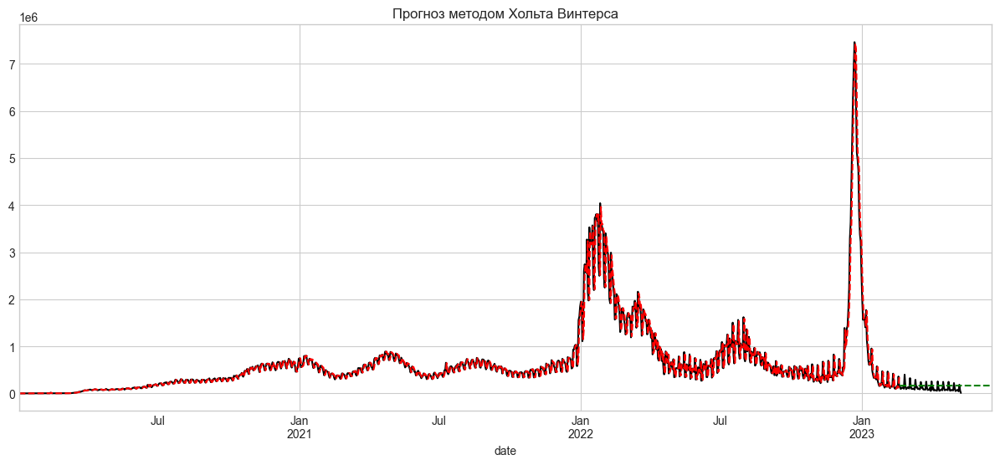

In [136]:
ax = df_case['new_cases'].plot(figsize=(15,6), color='black', title="Прогноз методом Хольта Винтерса" )
fit1.fittedvalues.plot(ax=ax, style='--', color='red')
fit1.forecast(120).plot(ax=ax, style='--', color='green')
plt.show()

In [137]:
metrics(train, fit1.fittedvalues)

Тест на стаціонарність:
	T-статистика = -8.376
	P-значення = 0.000
Критичне значення :
	1%: -3.4361864296062166 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.864117116658563 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5681421294173714 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 100443.4188
MSE: 43300020381.3055
MAPE: inf
MPE: nan
Стандартна похибка: 208086.5694


In [138]:
metrics(test, fit1.forecast(len(test)))

Тест на стаціонарність:
	T-статистика = -0.757
	P-значення = 0.832
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 78718.8105
MSE: 7391733639.2871
MAPE: 1.1037
MPE: -1.0071
Стандартна похибка: 85975.192


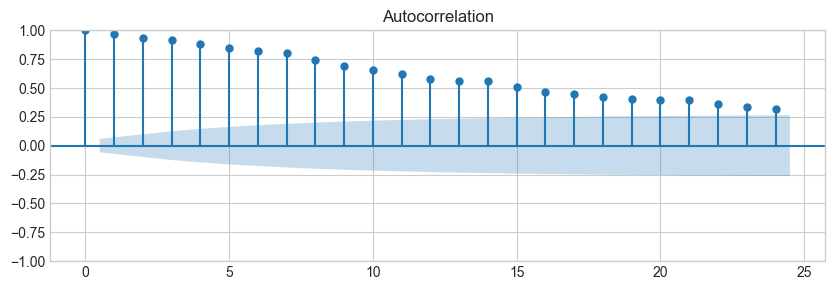

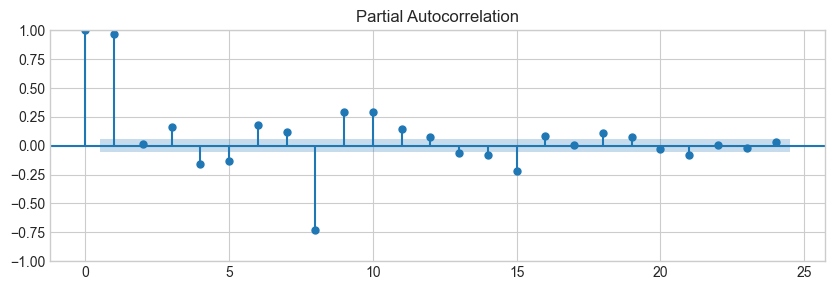

In [139]:
plt.rcParams.update({'figure.figsize': (10,3)})
plot_acf(train.new_cases, lags=24)
plot_pacf(train.new_cases, lags=24)
plt.show()

# 2.4 VARMAX

VARMAX без декомпозиції

In [140]:
predictions = 80

In [141]:
data = df_general.copy().astype(float)

In [142]:
train_data = df_general[:-predictions].astype(float)
test_data = df_general[-predictions:].astype(float)

In [143]:
endog = data[['new_cases', 'new_deaths']]

exog = data[['new_people_vaccinated_smoothed']]

model = sm.tsa.VARMAX(endog=endog, exog=exog, order=(1, 1))

In [144]:
results = model.fit()

In [145]:
mse = results.mse
rmse = np.sqrt(mse)
mape = np.mean(np.abs((endog - results.predict(exog=exog)) / endog)) * 100
mad = np.mean(np.abs(endog - results.predict(exog=exog)))
mpe = np.mean((endog - results.predict(exog=exog)) / endog) * 100

In [146]:
pred = results.forecast(steps=len(test_data), exog=exog[-predictions:])

In [147]:
print('MSE: ', mse)
print('RMSE: ', rmse)
print('MAPE: ', mape)
print('MPE: ', mpe)
print('MAD: ', mad)

MSE:  40503354298.21106
RMSE:  201254.4516233394
MAPE:  new_cases     inf
new_deaths    inf
dtype: float64
MPE:  new_cases    -inf
new_deaths   -inf
dtype: float64
MAD:  new_cases     99247.987068
new_deaths      725.255044
dtype: float64


In [148]:
pred = results.predict(start=test_data.index[0], end=test_data.index[-1])

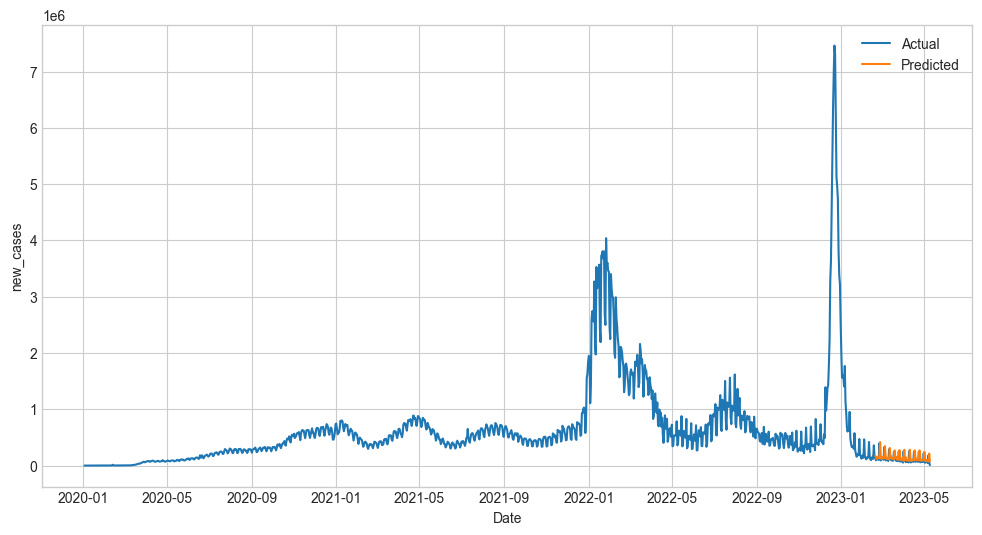

In [149]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(endog.index, endog['new_cases'], label='Actual')
ax.plot(pred.index, pred['new_cases'], label='Predicted')
ax.set_xlabel('Date')
ax.set_ylabel('new_cases')
ax.legend()
plt.show()

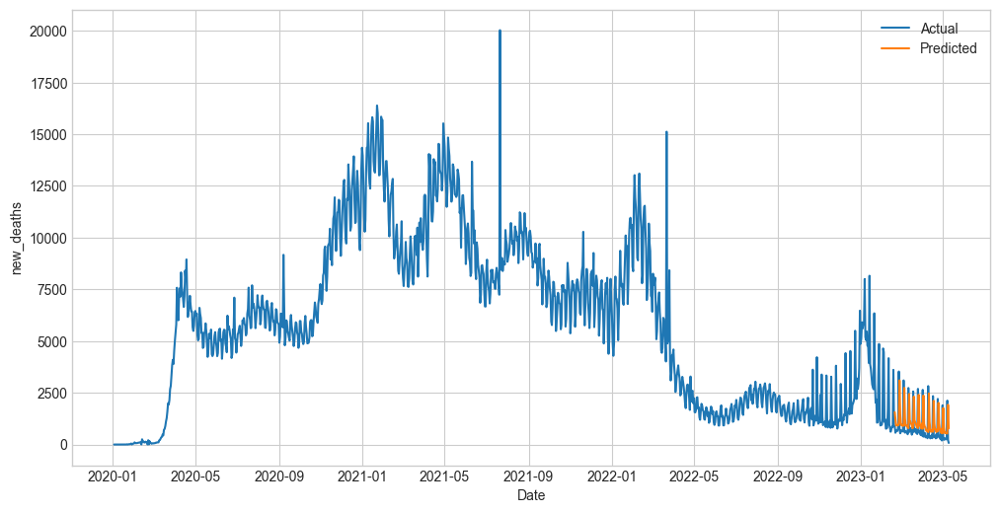

In [150]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(endog.index, endog['new_deaths'], label='Actual')
ax.plot(pred.index, pred['new_deaths'], label='Predicted')
ax.set_xlabel('Date')
ax.set_ylabel('new_deaths')
ax.legend()
plt.show()

# 2.5 Neular Network  (LSTM) Long Short-Term Memory

In [153]:
df_general_new_cases = df_general[['new_cases']]

Epoch 1/100
28/28 [==============================] - 2s 18ms/step - loss: 0.0050 - val_loss: 0.0073 - lr: 0.0010
Epoch 2/100
28/28 [==============================] - 0s 5ms/step - loss: 7.7939e-04 - val_loss: 0.0071 - lr: 0.0010
Epoch 3/100
28/28 [==============================] - 0s 5ms/step - loss: 6.0757e-04 - val_loss: 0.0072 - lr: 0.0010
Epoch 4/100
28/28 [==============================] - 0s 5ms/step - loss: 5.3915e-04 - val_loss: 0.0068 - lr: 0.0010
Epoch 5/100
28/28 [==============================] - 0s 5ms/step - loss: 5.3281e-04 - val_loss: 0.0071 - lr: 0.0010
Epoch 6/100
28/28 [==============================] - 0s 5ms/step - loss: 5.8542e-04 - val_loss: 0.0077 - lr: 0.0010
Epoch 7/100
28/28 [==============================] - 0s 5ms/step - loss: 5.7820e-04 - val_loss: 0.0069 - lr: 0.0010
Epoch 8/100
28/28 [==============================] - 0s 5ms/step - loss: 5.7083e-04 - val_loss: 0.0070 - lr: 0.0010
Epoch 9/100
28/28 [==============================] - 0s 5ms/step - loss: 5.

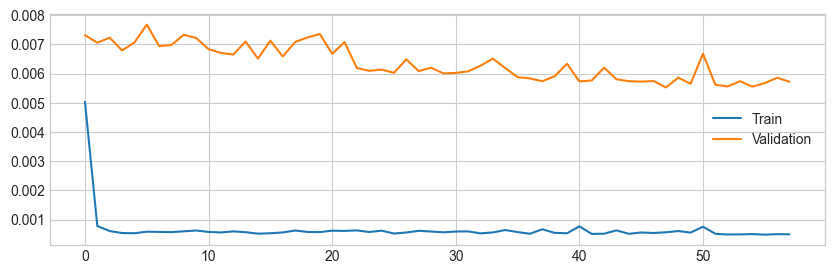

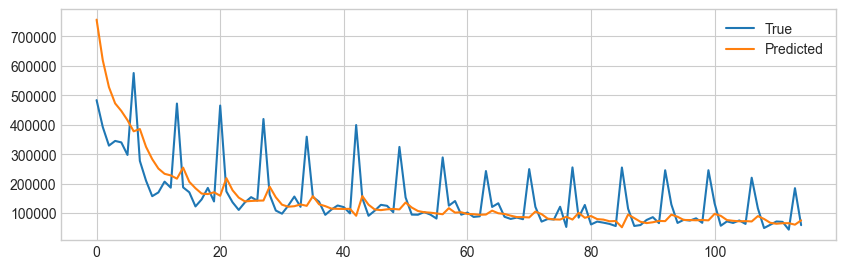

In [154]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler

# Scale the data using MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(df_general_new_cases)

# Split the data into training and testing sets
train_size = int(len(scaled_data) * 0.9)
test_size = len(scaled_data) - train_size
train_data, test_data = scaled_data[0:train_size,:], scaled_data[train_size:len(scaled_data),:]

# Define a function to create input/output pairs for the LSTM model
def create_dataset(dataset, time_steps=1):
    X, y = [], []
    for i in range(len(dataset)-time_steps-1):
        a = dataset[i:(i+time_steps), 0]
        X.append(a)
        y.append(dataset[i + time_steps, 0])
    return np.array(X), np.array(y)

# Define the number of time steps for the LSTM model
time_steps = 7

# Create input/output pairs for the training and testing sets
X_train, y_train = create_dataset(train_data, time_steps)
X_test, y_test = create_dataset(test_data, time_steps)

# Reshape the input data to fit the LSTM model
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Define the LSTM model architecture
model = Sequential()
model.add(LSTM(64, input_shape=(time_steps, 1)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

# Define early stopping and learning rate scheduler callbacks
earlystop = EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min')
def scheduler(epoch):
    if epoch < 50:
        return 0.001
    else:
        return 0.001 * np.exp(0.1 * (50 - epoch))

lrscheduler = LearningRateScheduler(scheduler)

# Train the LSTM model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, callbacks=[earlystop, lrscheduler])

# Generate predictions on the testing set
y_pred = model.predict(X_test)
y_pred = scaler.inverse_transform(y_pred)
y_test = scaler.inverse_transform([y_test])

# Calculate metrics for the predictions
metrics(y_pred.flatten(), y_test.flatten())

# Plot the training and validation loss over epochs
plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Validation')
plt.legend()
plt.show()

# Plot the true and predicted values of the testing set
plt.plot(y_test.flatten(), label='True')
plt.plot(y_pred.flatten(), label='Predicted')
plt.legend()
plt.show()

# 2.6 XGBoost 

In [154]:
predictions = 80

In [155]:
df_case = df_general.copy()
train = df_case[:-predictions][['new_cases']]
test = df_case[-predictions:][['new_cases']]

In [156]:
import xgboost as xgb

In [157]:
train = create_features(train)
test = create_features(test)

FEATURES = ['dayofyear', 'dayofweek', 'quarter', 'month', 'year']
TARGET = 'new_cases'

X_train = train[FEATURES]
y_train = train[TARGET]

X_test = test[FEATURES]
y_test = test[TARGET]

In [158]:
reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                       n_estimators=1000,
                       early_stopping_rounds=50,
                       objective='reg:linear',
                       max_depth=3,
                       learning_rate=0.01)
reg.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=100)

[17:13:48] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-0fc7796c793e6356f-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:1034034.20832	validation_1-rmse:122655.71196
[58]	validation_0-rmse:690225.03821	validation_1-rmse:423977.81735


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=50,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1000, n_jobs=None, num_parallel_tree=None,
             objective='reg:linear', predictor=None, ...)

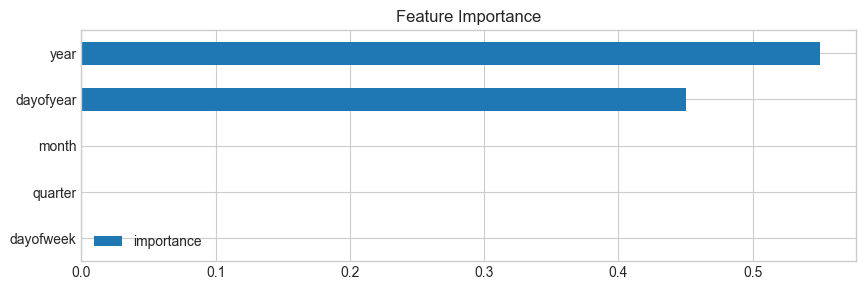

In [159]:
fi = pd.DataFrame(data=reg.feature_importances_,
             index=reg.feature_names_in_,
             columns=['importance'])
fi.sort_values('importance').plot(kind='barh', title='Feature Importance')
plt.show()

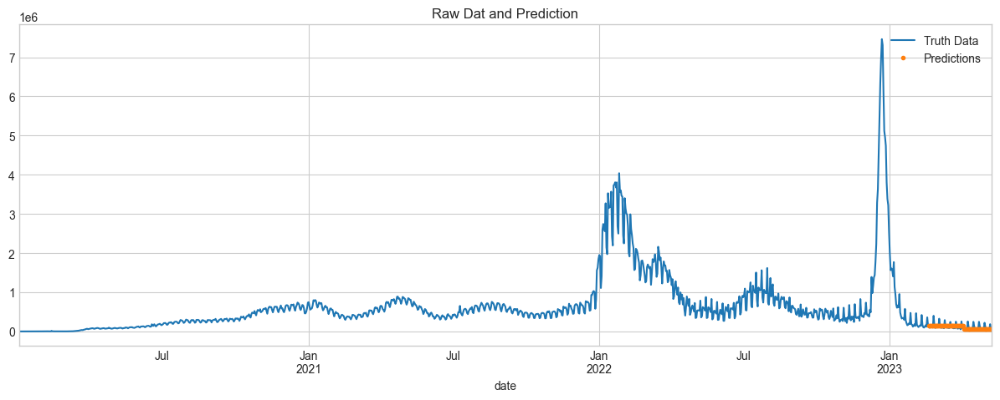

In [160]:
test['prediction'] = reg.predict(X_test)
df_case = df_case.merge(test[['prediction']], how='left', left_index=True, right_index=True)
ax = df_case[['new_cases']].plot(figsize=(15, 5))
df_case['prediction'].plot(ax=ax, style='.')
plt.legend(['Truth Data', 'Predictions'])
ax.set_title('Raw Dat and Prediction')
plt.show()

In [161]:
metrics(test['new_cases'], test['prediction'])

Тест на стаціонарність:
	T-статистика = -2.206
	P-значення = 0.204
Критичне значення :
	1%: -3.5319549603840894 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.905755128523123 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5903569458676765 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 47114.6898
MSE: 5103746136.8822
MAPE: 0.4234
MPE: -0.0833
Стандартна похибка: 71440.5077


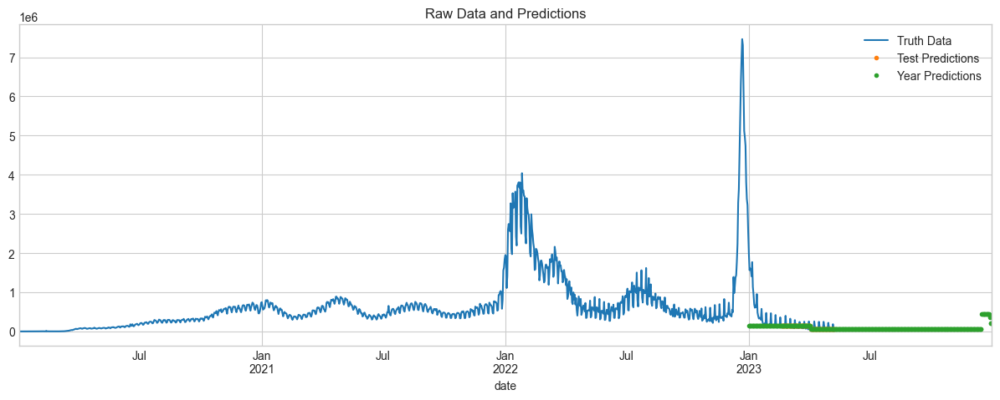

In [162]:
# Generate a DataFrame for the entire year
start_date = '2023-01-01'
end_date = '2023-12-31'
year_dates = pd.date_range(start=start_date, end=end_date, freq='D')
year_df = pd.DataFrame(index=year_dates)

# Add time series features to the DataFrame
year_df = create_features(year_df)

# Generate predictions for the entire year
year_df['prediction'] = reg.predict(year_df[FEATURES])

# Plot the predictions
ax = df_case[['new_cases']].plot(figsize=(15, 5))
df_case['prediction'].plot(ax=ax, style='.')
year_df['prediction'].plot(ax=ax, style='.')
plt.legend(['Truth Data', 'Test Predictions', 'Year Predictions'])
ax.set_title('Raw Data and Predictions')
plt.show()

# 2.7 Ансамблі

In [190]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from prophet import Prophet
from keras.models import Sequential
from keras.layers import Dense

In [304]:
prediction = 80

In [305]:
df_cases = df_general[['new_cases']].copy()

In [306]:
train = df_cases[:-prediction]
test = df_cases[-prediction:]

## SARIMAX+Prophet--->Neural Network

#### new_cases

In [307]:
# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
train['new_cases_transformed'] = transformer.fit_transform(train[['new_cases']])
test['new_cases_transformed'] = transformer.transform(test[['new_cases']])

# Навчання SARIMAX
order = (2,1,3)
seasonal_order = (0,0,0,12)

model_sarimax = SARIMAX(train['new_cases_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

pred = result_sarimax.forecast(steps=len(test))
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення серії для прогонозованих значень
start_date = test.index[0]
end_date = test.index[-1]

dates = pd.date_range(min(start_date, end_date), max(start_date, end_date)).tolist()

forecast_sarimax = pd.Series(data=pred, index=dates)

In [308]:
# Попередня обробка даних для Prophet
train = df_general[['new_cases']][:-prediction]
test = df_general[['new_cases']][-prediction:]

train.reset_index(inplace=True)
train.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

test.reset_index(inplace=True)
test.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [309]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(train)

future = model_prophet.make_future_dataframe(periods=prediction, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

17:55:03 - cmdstanpy - INFO - Chain [1] start processing
17:55:04 - cmdstanpy - INFO - Chain [1] done processing


In [310]:
# Об'єднання прогнозів

forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat'].tail(len(test)).values
})

In [311]:
# Навчання нейронної мережі на об'єднаних ознаках
model_nn = Sequential()
model_nn.add(Dense(12, input_dim=2, activation='relu'))
model_nn.add(Dense(8, activation='relu'))
model_nn.add(Dense(1, activation='linear'))
model_nn.compile(loss='mean_squared_error', optimizer='adam')
model_nn.fit(forecast_combined, test['y'], epochs=100, batch_size=10)

Epoch 1/100
8/8 [==============================] - 1s 2ms/step - loss: 12325693440.0000
Epoch 2/100
8/8 [==============================] - 0s 2ms/step - loss: 11237295104.0000
Epoch 3/100
8/8 [==============================] - 0s 1ms/step - loss: 10308794368.0000
Epoch 4/100
8/8 [==============================] - 0s 2ms/step - loss: 9454288896.0000
Epoch 5/100
8/8 [==============================] - 0s 1ms/step - loss: 8701863936.0000
Epoch 6/100
8/8 [==============================] - 0s 2ms/step - loss: 8066762240.0000
Epoch 7/100
8/8 [==============================] - 0s 1ms/step - loss: 7523011072.0000
Epoch 8/100
8/8 [==============================] - 0s 1ms/step - loss: 7125929984.0000
Epoch 9/100
8/8 [==============================] - 0s 3ms/step - loss: 6804027904.0000
Epoch 10/100
8/8 [==============================] - 0s 1ms/step - loss: 6485980160.0000
Epoch 11/100
8/8 [==============================] - 0s 2ms/step - loss: 6329578496.0000
Epoch 12/100
8/8 [====================

In [312]:
# Отримання прогнозів на тестовій вибирці
forecast_combined_test = pd.DataFrame({
    'sarimax': result_sarimax.forecast(steps=len(test)),
    'prophet': model_prophet.predict(test[['ds']])['yhat'].values
})
y_pred = model_nn.predict(forecast_combined_test)

3/3 [==============================] - 0s 2ms/step


In [313]:
# Оцінка точності моделі
metrics(test['y'], y_pred.flatten())

Тест на стаціонарність:
	T-статистика = -3.760
	P-значення = 0.003
Критичне значення :
	1%: -3.5319549603840894 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.905755128523123 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5903569458676765 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 63304.9039
MSE: 5978048992.1747
MAPE: 0.7503
MPE: -0.5546
Стандартна похибка: 77317.8439


### Прогноз

In [314]:
df_cases = df_general[['new_cases']]

In [315]:
# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [316]:
# Прогнозування за допомогою SARIMAX

# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
df_cases['new_cases_transformed'] = transformer.fit_transform(df_cases[['new_cases']])

# Навчання SARIMAX
 
order = (5,1,5)
seasonal_order = (2,0,0,12)

model_sarimax = SARIMAX(df_cases['new_cases_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

pred = result_sarimax.forecast(steps=365)
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')
dates = dates.to_list()

forecast_sarimax = pd.Series(data=pred, index=dates)

In [317]:
# Попередня обробка даних для Prophet
df_cases = df_general[['new_cases']]

df_cases.reset_index(inplace=True)
df_cases.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [318]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(df_cases)

future = model_prophet.make_future_dataframe(periods=365, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

17:55:17 - cmdstanpy - INFO - Chain [1] start processing
17:55:20 - cmdstanpy - INFO - Chain [1] done processing


In [319]:
# Об'єднання прогнозів
forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat_upper'].tail(365).values
})

In [320]:
df_cases = df_general[['new_cases']]

In [321]:
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [322]:
dates = dates.to_list()

In [323]:
# Прогноз на рік
forecast_year = model_nn.predict(forecast_combined)

# Обмеження від'ємних значень
forecast_year = np.maximum(forecast_year, 0)

# Створення DataFrame з прогнозом на рік
forecast_df = pd.DataFrame({
    'ds': dates,
    'y': forecast_year.flatten()
})

12/12 [==============================] - 0s 2ms/step


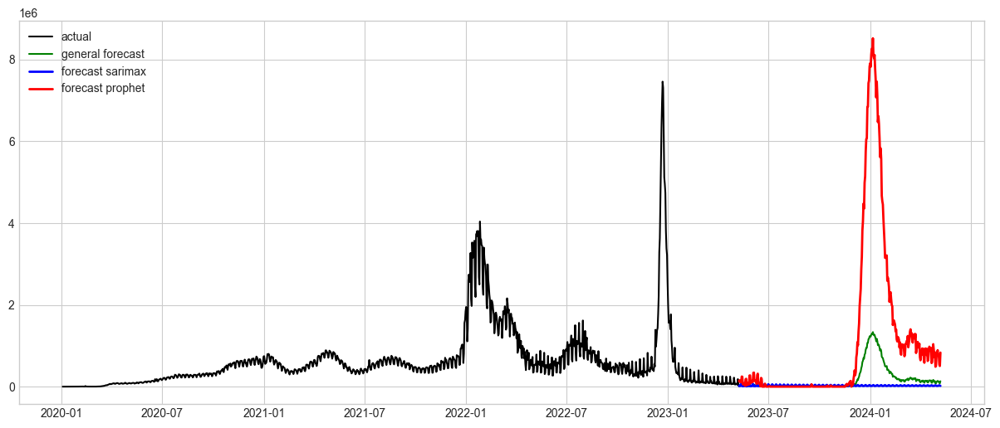

In [324]:
# Графік прогнозу
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(15,6))
plt.plot(df_cases.index, df_cases['new_cases'], label='actual', color='black')
plt.plot(forecast_df['ds'], forecast_df['y'], label='general forecast', color='green')
plt.plot(forecast_df['ds'], forecast_combined['sarimax'], label='forecast sarimax', color='blue', linewidth=2)
plt.plot(forecast_df['ds'], forecast_combined['prophet'], label='forecast prophet', color='red', linewidth=2)
plt.legend()
plt.show()

In [325]:
forecast_combined[['general forecast']] = forecast_df[['y']].values

In [326]:
forecast_combined

,sarimax,prophet,general forecast
2023-05-09,17644.681454,133806.420949,23357.632812
2023-05-10,24995.339277,155317.425282,27741.164062
2023-05-11,14089.112029,115211.287188,19958.029297
2023-05-12,24434.917843,129016.239109,23554.998047
2023-05-13,87257.598398,105459.582266,24201.398438
...,...,...,...
2024-05-03,20274.281159,753521.113163,120520.460938
2024-05-04,26850.420619,786149.675158,126532.632812
2024-05-05,33326.443154,542863.599489,89434.273438
2024-05-06,27337.223985,505726.012314,82799.523438


In [327]:
forecast_combined.to_csv('forecast_ensemble_sarimax+prophet.csv')

#### new_deaths

In [216]:
prediction = 80

df_cases = df_general[['new_deaths']]

train = df_cases[:-prediction]
test = df_cases[-prediction:]

# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
train['new_deaths_transformed'] = transformer.fit_transform(train[['new_deaths']])
test['new_deaths_transformed'] = transformer.transform(test[['new_deaths']])

# Навчання SARIMAX

model = auto_arima(train['new_deaths_transformed'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)

order = model.order
seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(train['new_deaths_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

pred = result_sarimax.forecast(steps=len(test))
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення серії для прогонозованих значень

start_date = test.index[0]
end_date = test.index[-1]

dates = pd.date_range(min(start_date, end_date), max(start_date, end_date)).tolist()

forecast_sarimax = pd.Series(data=pred, index=dates)

# Попередня обробка даних для Prophet
train = df_general[['new_deaths']][:-prediction]
test = df_general[['new_deaths']][-prediction:]

train.reset_index(inplace=True)
train.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

test.reset_index(inplace=True)
test.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(train)

future = model_prophet.make_future_dataframe(periods=prediction, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

# Об'єднання прогнозів

forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat'].tail(len(test)).values
})

# Навчання нейронної мережі на об'єднаних ознаках
model_nn = Sequential()
model_nn.add(Dense(12, input_dim=2, activation='relu'))
model_nn.add(Dense(8, activation='relu'))
model_nn.add(Dense(1, activation='linear'))
model_nn.compile(loss='mean_squared_error', optimizer='adam')
model_nn.fit(forecast_combined, test['y'], epochs=100, batch_size=10)

# Отримання прогнозів на тестовій вибирці
forecast_combined_test = pd.DataFrame({
    'sarimax': result_sarimax.forecast(steps=len(test)),
    'prophet': model_prophet.predict(test[['ds']])['yhat'].values
})
y_pred = model_nn.predict(forecast_combined_test)

# Оцінка точності моделі

metrics(test['y'], y_pred.flatten())

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-125.007, Time=2.74 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=152.400, Time=0.08 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=54.658, Time=0.41 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-54.077, Time=0.78 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=150.409, Time=0.05 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-293.199, Time=2.49 sec
 ARIMA(2,1,2)(0,0,0)[12] intercept   : AIC=-312.535, Time=1.23 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-309.038, Time=3.03 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=-97.601, Time=0.56 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=-110.797, Time=0.62 sec
 ARIMA(3,1,2)(0,0,0)[12] intercept   : AIC=-398.964, Time=1.27 sec
 ARIMA(3,1,2)(1,0,0)[12] intercept   : AIC=-447.669, Time=2.96 sec
 ARIMA(3,1,2)(2,0,0)[12] intercept   : AIC=-441.223, Time=8.39 sec
 ARIMA(3,1,2)(1,0,1)[12] intercept   : AIC=-424.938, Time=3.57 sec
 ARIMA(3,1,2)(0,0,1)[12] 

17:21:18 - cmdstanpy - INFO - Chain [1] start processing
17:21:18 - cmdstanpy - INFO - Chain [1] done processing


Epoch 1/100
8/8 [==============================] - 0s 1ms/step - loss: 609663.7500
Epoch 2/100
8/8 [==============================] - 0s 2ms/step - loss: 606796.3125
Epoch 3/100
8/8 [==============================] - 0s 3ms/step - loss: 606140.7500
Epoch 4/100
8/8 [==============================] - 0s 2ms/step - loss: 605903.8750
Epoch 5/100
8/8 [==============================] - 0s 2ms/step - loss: 606730.7500
Epoch 6/100
8/8 [==============================] - 0s 2ms/step - loss: 606601.5000
Epoch 7/100
8/8 [==============================] - 0s 2ms/step - loss: 606177.6250
Epoch 8/100
8/8 [==============================] - 0s 2ms/step - loss: 606342.8750
Epoch 9/100
8/8 [==============================] - 0s 2ms/step - loss: 606576.6875
Epoch 10/100
8/8 [==============================] - 0s 3ms/step - loss: 605596.6875
Epoch 11/100
8/8 [==============================] - 0s 3ms/step - loss: 605762.6250
Epoch 12/100
8/8 [==============================] - 0s 2ms/step - loss: 606344.3750
E

### Прогноз

In [217]:
df_deaths = df_general[['new_deaths']]

In [218]:
# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [219]:
# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
df_deaths['new_deaths_transformed'] = transformer.fit_transform(df_deaths[['new_deaths']])

In [220]:
model = auto_arima(df_deaths['new_deaths_transformed'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-78.055, Time=2.47 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=258.214, Time=0.07 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=110.862, Time=0.43 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-45.731, Time=0.56 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=256.215, Time=0.07 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-74.384, Time=1.42 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-69.175, Time=1.57 sec
 ARIMA(2,1,2)(2,0,1)[12] intercept   : AIC=-144.224, Time=7.96 sec
 ARIMA(2,1,2)(2,0,0)[12] intercept   : AIC=-267.670, Time=8.51 sec
 ARIMA(1,1,2)(2,0,0)[12] intercept   : AIC=-263.288, Time=6.48 sec
 ARIMA(2,1,1)(2,0,0)[12] intercept   : AIC=36.583, Time=6.89 sec
 ARIMA(3,1,2)(2,0,0)[12] intercept   : AIC=-373.633, Time=7.54 sec
 ARIMA(3,1,2)(1,0,0)[12] intercept   : AIC=-400.141, Time=3.03 sec
 ARIMA(3,1,2)(0,0,0)[12] intercept   : AIC=-383.708, Time=1.25 sec
 ARIMA(3,1,2)(1,0,1)[12] int

In [221]:
order = model.order
seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(df_deaths['new_deaths_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

# pred = results.forecast(steps=len(test))
pred = result_sarimax.forecast(steps=365)
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')
dates = dates.to_list()

forecast_sarimax = pd.Series(data=pred, index=dates)

17:24:06 - cmdstanpy - INFO - Chain [1] start processing
17:24:07 - cmdstanpy - INFO - Chain [1] done processing


12/12 [==============================] - 0s 914us/step


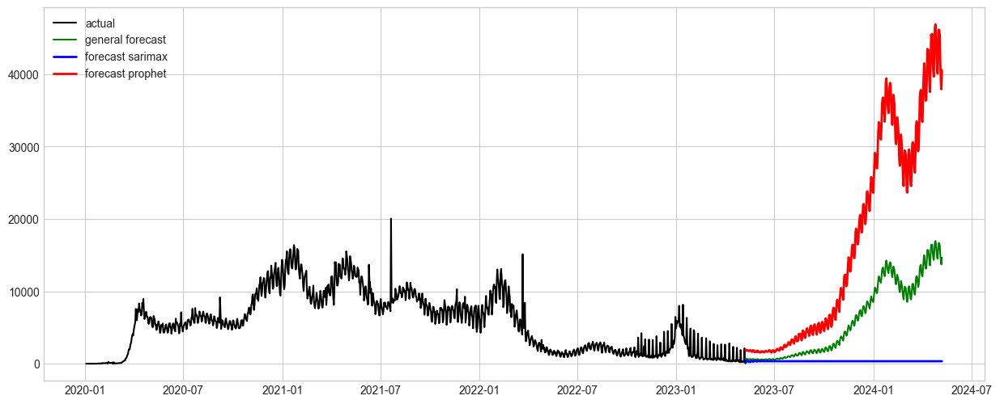

,sarimax,prophet,general forecast
2023-05-09,107.578178,1976.762842,710.237915
2023-05-10,230.463036,1808.899289,641.425049
2023-05-11,402.838625,1897.201949,655.873047
2023-05-12,447.970409,1878.593361,644.307434
2023-05-13,440.125544,1854.906221,636.415466
...,...,...,...
2024-05-03,344.624335,45389.132901,16408.714844
2024-05-04,344.624335,41677.051228,15065.381836
2024-05-05,344.624335,39105.202766,14134.677734
2024-05-06,344.624335,37901.109516,13698.937500


In [222]:
# Попередня обробка даних для Prophet
df_deaths = df_general[['new_deaths']]

df_deaths.reset_index(inplace=True)
df_deaths.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(df_deaths)

future = model_prophet.make_future_dataframe(periods=365, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

    
    
# Об'єднання прогнозів
forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat_upper'].tail(365).values
})


df_deaths = df_general[['new_deaths']]


dates = pd.date_range(start=df_deaths.index[-1], periods=365, freq='D')

dates = dates.to_list()


# Прогноз на рік
forecast_year = model_nn.predict(forecast_combined)

# Обмеження від'ємних значень
forecast_year = np.maximum(forecast_year, 0)

# Створення DataFrame з прогнозом на рік
forecast_df = pd.DataFrame({
    'ds': dates,
    'y': forecast_year.flatten()
})


# Графік прогнозу
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(15,6))
plt.plot(df_cases.index, df_deaths['new_deaths'], label='actual', color='black')
plt.plot(forecast_df['ds'], forecast_df['y'], label='general forecast', color='green')
plt.plot(forecast_df['ds'], forecast_combined['sarimax'], label='forecast sarimax', color='blue', linewidth = 2)
plt.plot(forecast_df['ds'], forecast_combined['prophet'], label='forecast prophet', color='red', linewidth = 2)
plt.legend()
plt.show()

forecast_combined[['general forecast']] = forecast_df[['y']].values

forecast_combined


## Prophet + Holt-Winter's --->Neural Network

In [223]:
prediction = 80
df_cases = df_general[['new_cases']]
train = df_cases[:-prediction]
test = df_cases[-prediction:]

In [226]:
holt_winters = ExponentialSmoothing(train, seasonal_periods=12, trend='add').fit()

In [227]:
pred = holt_winters.forecast(steps=len(test))

In [228]:
metrics(test, pred)

Тест на стаціонарність:
	T-статистика = -0.757
	P-значення = 0.832
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 78718.8105
MSE: 7391733639.2871
MAPE: 1.1037
MPE: -1.0071
Стандартна похибка: 85975.192


In [229]:
start_date = test.index[0]
end_date = test.index[-1]

dates = pd.date_range(min(start_date, end_date), max(start_date, end_date)).tolist()

forecast_holt_winters = pd.Series(data=pred, index=dates)

In [230]:
# Попередня обробка даних для Prophet
train = df_general[['new_cases']][:-prediction]
test = df_general[['new_cases']][-prediction:]

train.reset_index(inplace=True)
train.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

test.reset_index(inplace=True)
test.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [231]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(train)

future = model_prophet.make_future_dataframe(periods=prediction, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

17:27:27 - cmdstanpy - INFO - Chain [1] start processing
17:27:28 - cmdstanpy - INFO - Chain [1] done processing


In [232]:
# Об'єднання прогнозів

forecast_combined = pd.DataFrame({
    'holt_winters': forecast_holt_winters,
    'prophet': forecast_prophet['yhat'].tail(len(test)).values
})

In [233]:
# Навчання нейронної мережі на об'єднаних ознаках
model_nn = Sequential()
model_nn.add(Dense(12, input_dim=2, activation='relu'))
model_nn.add(Dense(8, activation='relu'))
model_nn.add(Dense(1, activation='linear'))
model_nn.compile(loss='mean_squared_error', optimizer='adam')
model_nn.fit(forecast_combined, test['y'], epochs=100, batch_size=10)

Epoch 1/100
8/8 [==============================] - 0s 1ms/step - loss: 26667259904.0000
Epoch 2/100
8/8 [==============================] - 0s 2ms/step - loss: 25805232128.0000
Epoch 3/100
8/8 [==============================] - 0s 1ms/step - loss: 24974456832.0000
Epoch 4/100
8/8 [==============================] - 0s 2ms/step - loss: 24201617408.0000
Epoch 5/100
8/8 [==============================] - 0s 2ms/step - loss: 23452119040.0000
Epoch 6/100
8/8 [==============================] - 0s 2ms/step - loss: 22761969664.0000
Epoch 7/100
8/8 [==============================] - 0s 2ms/step - loss: 22055966720.0000
Epoch 8/100
8/8 [==============================] - 0s 2ms/step - loss: 21432430592.0000
Epoch 9/100
8/8 [==============================] - 0s 2ms/step - loss: 20829958144.0000
Epoch 10/100
8/8 [==============================] - 0s 2ms/step - loss: 20204826624.0000
Epoch 11/100
8/8 [==============================] - 0s 2ms/step - loss: 19630434304.0000
Epoch 12/100
8/8 [============

In [234]:
forecast_combined_test = pd.DataFrame({
    'holt_winters': fit1.forecast(steps=len(test)),
    'prophet': model_prophet.predict(test[['ds']])['yhat'].values
})
y_pred = model_nn.predict(forecast_combined_test)

3/3 [==============================] - 0s 2ms/step


In [235]:
metrics(test['y'], y_pred.flatten())

Тест на стаціонарність:
	T-статистика = -2.073
	P-значення = 0.256
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 92142.1745
MSE: 13271245864.8044
MAPE: 0.757
MPE: 0.757
Стандартна похибка: 115200.8935


### Прогноз

In [245]:
prediction = 80
df_cases = df_general[['new_cases']]
train = df_cases[:-prediction]
test = df_cases[-prediction:]

In [246]:
holt_winters = ExponentialSmoothing(df_cases, seasonal_periods=12, trend='add').fit()

pred = holt_winters.forecast(steps=365)

dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')
dates = dates.to_list()

forecast_holt_winters = pd.Series(data=pred, index=dates)

In [247]:
# Попередня обробка даних для Prophet
df_cases = df_general[['new_cases']]

df_cases.reset_index(inplace=True)
df_cases.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [248]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(df_cases)

future = model_prophet.make_future_dataframe(periods=365, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

17:33:45 - cmdstanpy - INFO - Chain [1] start processing
17:33:47 - cmdstanpy - INFO - Chain [1] done processing


In [249]:
# Об'єднання прогнозів
forecast_combined = pd.DataFrame({
    'holt_winters': forecast_holt_winters,
    'prophet': forecast_prophet['yhat_upper'].tail(365).values
})

In [251]:
df_cases = df_general[['new_cases']]

dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

dates = dates.to_list()

# Прогноз на рік
forecast_year = model_nn.predict(forecast_combined)

#Обмеження від'ємних значень
forecast_year = np.maximum(forecast_year, 0)

# Створення DataFrame з прогнозом на рік
forecast_df = pd.DataFrame({
    'ds': dates,
    'y': forecast_year.flatten()
})

12/12 [==============================] - 0s 1ms/step


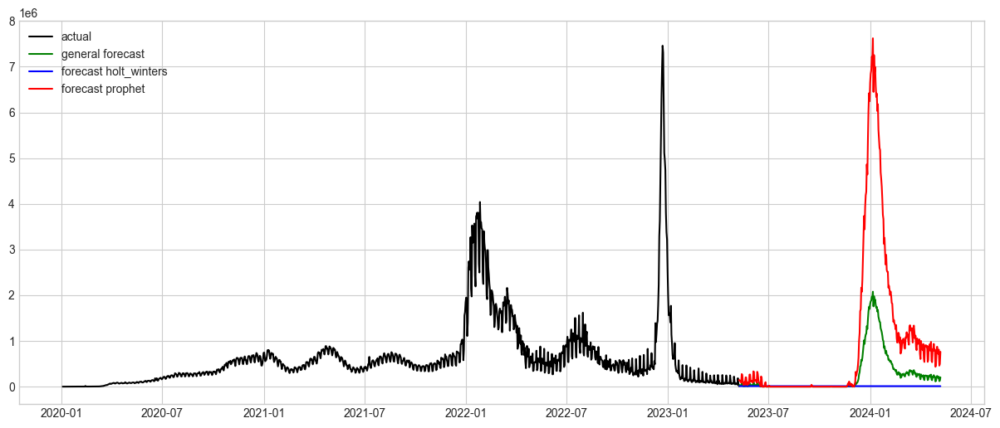

In [253]:
# Графік прогнозу
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(15,6))
plt.plot(df_cases.index, df_cases['new_cases'], label='actual', color='black')
plt.plot(forecast_df['ds'], forecast_df['y'], label='general forecast', color='green')
plt.plot(forecast_df['ds'], forecast_combined['holt_winters'], label='forecast holt_winters', color='blue')
plt.plot(forecast_df['ds'], forecast_combined['prophet'], label='forecast prophet', color='red')
plt.legend()
plt.show()

### ARIMA + ETS

In [254]:
prediction = 80
df_cases = df_general[['new_cases']]
train = df_cases[:-prediction]
test = df_cases[-prediction:]

RMSE for ARIMA model: 80605.61676354877
RMSE for ETS model: 85024.87858405549
Тест на стаціонарність:
	T-статистика = -0.767
	P-значення = 0.829
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 74489.1085
MSE: 6842710494.076
MAPE: 1.0399
MPE: -0.937
Стандартна похибка: 82720.6775


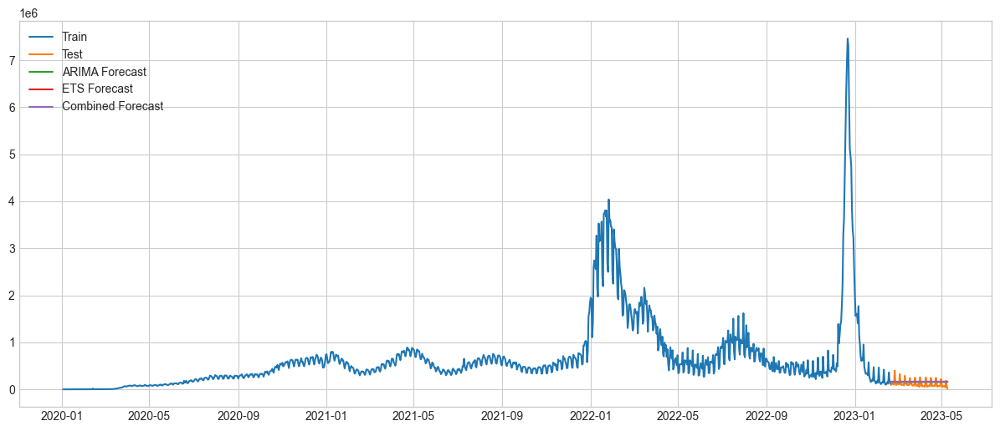

In [255]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_squared_error

# Fit ARIMA model
arima_model = ARIMA(train, order=(2,1,0))
arima_fit = arima_model.fit()

# Fit ETS model
ets_model = ExponentialSmoothing(train, trend='add', seasonal='add', seasonal_periods=12)
ets_fit = ets_model.fit()

# Make forecasts with both models
arima_forecast = arima_fit.forecast(steps=prediction)
ets_forecast = ets_fit.forecast(steps=prediction)

# Combine forecasts with equal weighting
combined_forecast = (arima_forecast + ets_forecast) / 2

# Calculate RMSE for ARIMA model
arima_rmse = np.sqrt(mean_squared_error(test, arima_forecast))

# Calculate RMSE for ETS model
ets_rmse = np.sqrt(mean_squared_error(test, ets_forecast))

print(f'RMSE for ARIMA model: {arima_rmse}')
print(f'RMSE for ETS model: {ets_rmse}')

metrics(test, combined_forecast)

# Plot actual vs. forecasted values
fig, ax = plt.subplots(figsize=(15,6))
plt.plot(train.index, train.values, label='Train')
plt.plot(test.index, test.values, label='Test')
plt.plot(test.index, arima_forecast, label='ARIMA Forecast')
plt.plot(test.index, ets_forecast, label='ETS Forecast')
plt.plot(test.index, combined_forecast, label='Combined Forecast')
plt.legend()
plt.show()

### RandomForest

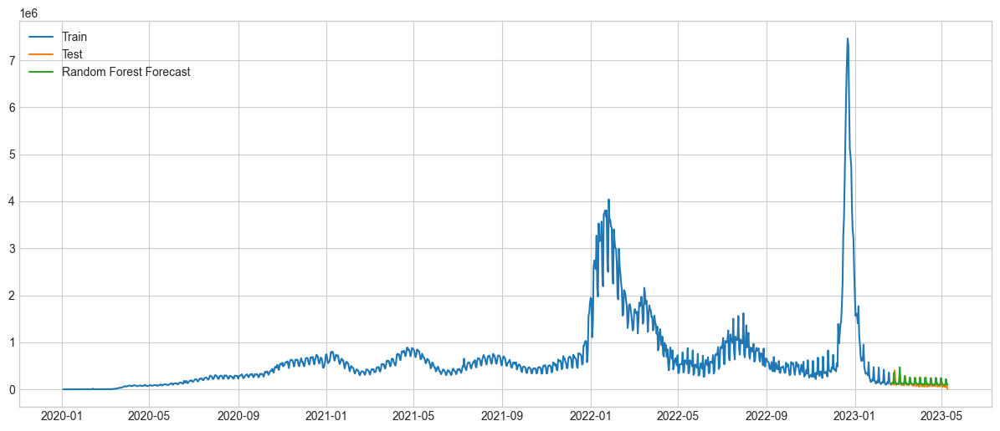

Тест на стаціонарність:
	T-статистика = -13.586
	P-значення = 0.000
Критичне значення :
	1%: -3.5159766913976376 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.898885703483903 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5866935058484217 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 38078.5645
MSE: 3601042086.1574
MAPE: 0.5359
MPE: -0.4856
Стандартна похибка: 60008.6834


In [256]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Extract time series features
train_features = []
train_target = []
for i in range(prediction, len(train)):
    train_features.append(train.iloc[i-prediction:i].values.flatten())
    train_target.append(train.iloc[i])
train_features = np.array(train_features)
train_target = np.array(train_target)

# Fit random forest regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(train_features, train_target)

# Make forecasts with random forest model
test_features = []
for i in range(prediction, len(df_cases)):
    test_features.append(df_cases.iloc[i-prediction:i].values.flatten())
test_features = np.array(test_features)
rf_forecast = rf_model.predict(test_features)[-prediction:]

# Plot actual vs. forecasted values
fig, ax = plt.subplots(figsize=(15,6))
plt.plot(train.index, train.values, label='Train')
plt.plot(test.index, test.values, label='Test')
plt.plot(test.index, rf_forecast, label='Random Forest Forecast')
plt.legend()
plt.show()

metrics(test, rf_forecast)

# Висновки

В роботі проведено дослідження щодо прогнозування поширення СOVID-19 у світі за допомогою методів машинного та глибокого навчання на основі даних з датасету owid-covid-data.csv.

Було здійснено попередню обробку, включаючи заповнення пропущених даних та приведення до формату часових рядів для подальшого аналізу. 

До розгляду бралася інформація щодо нових випадків захворювання на короновірусну інфекцію за день; нові випадки смертей, спричинених хворобою в день (як ендогенні показники); кількість вакцинованих в день (екзогенний показник).

В якості основних моделей машинного навчання використовувалися Prophet та SARIMAX, а також їх поєднання у ансамбль за допомогою нейронної мережі. 
Окрім них слід приділити увагу моделям VARMAX та Хольта-Вінтерса. 

В якості додаткових моделей для порівняння були використані також Neural Network (LSTM), XGBoost, ансамбль ARIMA + ETS, RandomForest. 




Згідно проведеного дослідження отримано наступні метрики для моделей машинного навчання:

### new_cases

|             Моделі \ Метрики                 |    MAD     |   MAPE      |    MPE    |    RMSE     |
|:-------------------------------------------:|:----------:|:-----------:|:---------:|:-----------:|
| Prophet (without exog)                      | 113889.1   | 1.0         | 1.0       |133058.6484  |
| Prophet (with exog)                         |158610.4644 | 1.4262      | 0.3238    |237490.6668  |
| SARIMAX (without exog; Yeo-Jonson)          |170460.4472 |-194729.5115 |194729.5115|172785.762   |
| SARIMAX (with exog; NNLS)                   |90037.949   |1.244        |-1.125     |100738.47    |
| VARMAX                                      |99247.987   | inf         | -inf      |201254.451   |
| Holt-Winters                                |78718.8105  | 1.1037      | -1.0071   |85975.192    |
| Neural Network (LSTM)                       |92490.7455  |3.8283       | -3.7834    |124005.5445  |
| XGBoost                                     |47114.689   |0.4234       | -0.0833   |71440.5077   |
| Ансамбль     ARIMA + ETS                    |74489.1085  |1.0399       | -0.937   |82720.6775   |
| RandomForest                                |38078.5645  |0.5359       | -0.4856   |60008.6834   |
| Ансамбль SARIMAX+Prophet--->Neural Network  |63304.9039  |0.7503       | -0.5546   |77317.8439  |
| Holt-Winters+Prophet--->Neural Network      |92142.1745  |0.757       | 0.757    |115200.8935  |

### new_deaths

|             Моделі \ Метрики                |    MAD     |   MAPE      |    MPE    |    RMSE     |
|:-------------------------------------------:|:----------:|:-----------:|:---------:|:-----------:|
| Prophet (without exog)                      | 1724.902   | 4.3265      | -4.3012   |1846.1834   |
| Prophet (with exog)                         |1729.3018   | 4.3765      | -4.349    |1856.3741   |
| VARMAX                                      |725.255     | inf         | -inf      |201254.451  |
| Ансамбль SARIMAX+Prophet--->Neural Network  |566.0124    |1.1049       | -0.9189   |780.1088   |

Порівнюючи метрики моделей Prophet з екзогенними чинниками та без у випадку new_cases, можна зауважити, що відхилення менше в моделі Prophet (without exog). Що стосується смертності внаслідок хвороби (new_deaths) — відхилення співставні. 

(До останнього оновлення даних вихідного датасету відхилення у Prophet (with exog) були значно менші, оскільки вакцинація впливає не на поширення хвороби, а на її перебіг. Проте після оновлення даних відхилення співставні. Це може бути спричинене тим, що інформація по вакцинації перестала збиратися)

Прогноз на рік цієї моделі передбачає можливий сплеск захворюваності згідно верхньої межі довірчого інтервалу наприкінці 2023 — на початку 2024 роках. Проте в середньому дані прямують до нуля (як для поширення хвороби, так і для смертності).

Інші моделі передбачають знаходження захворюваності на певному низькому рівні (зокрема SARIMAX, Хольта-Вінтерса тощо).

Найбільше відхилення з поміж моделей без екзогених факторів спостерігається у нейронної мережі, що може бути спричиненим недостатньою кількістю даних для навчання та нестаціонарністю даних.

Найбільш прийнятна модель на мою думку є ансамбль Prophet та SARIMAX, поєднаний за допомогою нейронної мережі. Він усуває велике значення MAPE та MPE для SARIMAX, і значно зменшує відхилення.
Згідно цієї моделі, сплекс захворюваності можливий на межі 2023-2024 років, але не такий великий як у випадку верхної межі довірчого інтервалу в моделі Prophet.

В загалом можна зробити висновок, що пандемія COVID-19 прямує до завершенння, а сама хвороба переходить у категорію "звичайних" сезонних хвороб зимнього періоду. 